In [1]:
import os
import string
import glob

import tensorflow.keras.preprocessing.image
from time import time
import numpy as np
from PIL import Image

import tensorflow.keras.preprocessing.image
import pickle

from tensorflow.keras import backend as K

from tensorflow.keras.layers import add
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Model
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import Input, layers

from tensorflow.keras.models import Model
from numpy import dot
from numpy.linalg import norm

HEIGHT=224
WIDTH=224

In [2]:
from tensorflow.keras.applications.vgg16 import VGG16
encode_model = VGG16()
print(encode_model.summary())


Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [3]:
import itertools 
  
def findsubsets(s, n): 
    return list(itertools.combinations(s, n)) 


In [4]:
from nltk.translate.bleu_score import sentence_bleu
reference = 'this is a test sentence'
candidate = 'this is also a test sentence'
print([reference.split()])
print(candidate.split())

score = sentence_bleu([reference.split()], candidate.split())
print(score)

[['this', 'is', 'a', 'test', 'sentence']]
['this', 'is', 'also', 'a', 'test', 'sentence']
7.262123179505913e-78


C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


In [5]:
def cosine_similarity(a, b):
    return dot(a, b)/(norm(a)*norm(b))

In [6]:
def bestCaption(candidateCaptions, m):
    bestNow = ''
    maxSim = 0
    
    if len(candidateCaptions) < m:
        m = len(candidateCaptions)
    
    for caption1 in candidateCaptions:
        lis = []
        Reference = [caption1]
        for idx in range(len(candidateCaptions)):
            lis.append(nltk.translate.bleu_score.sentence_bleu(Reference, candidateCaptions[idx]))
        lis.sort()
        lis = lis[-m:]
        sim = sum(lis)
        if sim > maxSim:
            bestNow = caption1
            maxSim = sim
        
    return [bestNow, maxSim/(5*m)]

In [7]:
def prepKNN(img_id):
    return KNN(encoding_test[img_id])

In [8]:
def prepKNNdev(img_id):
    return KNN(encoding_dev[img_id])

In [9]:
def AdaptiveKNN(feature_vector, trained_data, captionMap, k, m, threshold):
    similarityList = []
    
    for img_id in trained_data:
        sim = cosine_similarity(feature_vector, trained_data[img_id])
        similarityList.append((sim, img_id))
    
    similarityList.sort()
    similarityList = similarityList[-k:]
    adaptiveList = []
    adaptiveList.append(similarityList[k-1])
    
    for i in range(k-2, -1, -1):
        if similarityList[i + 1][0] - similarityList[i][0] < threshold:
            break;
        adaptiveList.append(similarityList[i])
    
    candidateCaptions = []
    for pair in adaptiveList:
        for caption in captionMap[pair[1]]:
            candidateCaptions.append(caption.split())
           
    return bestCaption(candidateCaptions, m)

In [10]:
root_captioning = "D:\\flickr8k\\Flickr8k"
rc='D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'
img = glob.glob(os.path.join(rc, '*.jpg'))
print(img)

['D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1000268201_693b08cb0e.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1001773457_577c3a7d70.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1002674143_1b742ab4b8.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1003163366_44323f5815.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1007129816_e794419615.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1007320043_627395c3d8.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1009434119_febe49276a.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1012212859_01547e3f17.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1015118661_980735411b.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\1015584366_dfcec3c85a.jpg', 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset\\101654506_8eb26cfb60.jpg', 'D:\\flickr8k\\Flickr

In [11]:
#LOAD DATASET
train_images_path = os.path.join(root_captioning,'Flickr8k_text','Flickr_8k.trainImages.txt') 
train_images = set(open(train_images_path, 'r').read().strip().split('\n'))
test_images_path = os.path.join(root_captioning,'Flickr8k_text','Flickr_8k.testImages.txt') 
test_images = set(open(test_images_path, 'r').read().strip().split('\n'))

dev_images_path = os.path.join(root_captioning,'Flickr8k_text','Flickr_8k.devImages.txt') 
dev_images = set(open(dev_images_path, 'r').read().strip().split('\n'))

train_img = []
test_img = []
dev_img=[]

for i in img:
  f = os.path.split(i)[-1]
  if f in train_images: 
    train_img.append(f) 
  elif f in test_images:
    test_img.append(f)
  else:
    dev_img.append(f)

In [12]:
null_punct = str.maketrans('', '', string.punctuation)
lookup = dict()
root_captioning = "D:\\flickr8k\\Flickr8k\\Flickr8k_text"

with open( os.path.join(root_captioning,'','Flickr8k.token.txt'), 'r') as fp:
  
  max_length = 0
  for line in fp.read().split('\n'):
    tok = line.split()
    if len(line) >= 2:
      id = tok[0].split('.')[0]
      id = id + '.jpg'
      desc = tok[1:]
      listToStr = ' '.join([str(elem) for elem in desc])   
#       # Cleanup description
#       desc = [word.lower() for word in desc]  #lowercase all words
#       desc = [w.translate(null_punct) for w in desc] # remove punctuations
#       desc = [word for word in desc if len(word)>1] #remove small words
#       desc = [word for word in desc if word.isalpha()]  #remove all digits
#       max_length = max(max_length,len(desc)) #calculate the max length of the caption
      
      if id not in lookup:
        lookup[id] = list()
      lookup[id].append(listToStr)
    
print(lookup)

{'1000268201_693b08cb0e.jpg': ['A child in a pink dress is climbing up a set of stairs in an entry way .', 'A girl going into a wooden building .', 'A little girl climbing into a wooden playhouse .', 'A little girl climbing the stairs to her playhouse .', 'A little girl in a pink dress going into a wooden cabin .'], '1001773457_577c3a7d70.jpg': ['A black dog and a spotted dog are fighting', 'A black dog and a tri-colored dog playing with each other on the road .', 'A black dog and a white dog with brown spots are staring at each other in the street .', 'Two dogs of different breeds looking at each other on the road .', 'Two dogs on pavement moving toward each other .'], '1002674143_1b742ab4b8.jpg': ['A little girl covered in paint sits in front of a painted rainbow with her hands in a bowl .', 'A little girl is sitting in front of a large painted rainbow .', 'A small girl in the grass plays with fingerpaints in front of a white canvas with a rainbow on it .', 'There is a girl with pigt

In [13]:
from tensorflow.keras import backend as K
def encodeImage(img):
  # Resize all images to a standard size (specified bythe image encoding network)
  img = img.resize((WIDTH, HEIGHT), Image.ANTIALIAS)
  # Convert a PIL image to a numpy array
  x = tensorflow.keras.preprocessing.image.img_to_array(img)
  # reshape data for the model
  x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
  # Perform any preprocessing needed by InceptionV3 or others
  x = preprocess_input(x)
    
  get_fc_layer_output = K.function([encode_model.layers[0].input], [encode_model.layers[-2].output])
  layer_output = get_fc_layer_output([x])[0]
  
  return layer_output[0]

In [14]:
root_captioning = "D:\\flickr8k\\Flickr8k"
train_path = os.path.join(root_captioning,"data",f'train.pkl')
if not os.path.exists(train_path):
  start = time()
  encoding_train = {}
  for id in train_img:
    image_path = os.path.join('E:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flicker8k_Dataset', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_train[id] = encodeImage(img)
  with open(train_path, "wb") as fp:
    pickle.dump(encoding_train, fp)
  
else:
  with open(train_path, "rb") as fp:
    encoding_train = pickle.load(fp)

# print(encoding_train)

In [15]:
print(len(encoding_train))

6000


In [16]:
root_captioning = "D:\\flickr8k\\Flickr8k"
dev_path = os.path.join(root_captioning,"data",f'dev.pkl')
if not os.path.exists(train_path):
  start = time()
  encoding_dev = {}
  for id in dev_img:
    image_path = os.path.join('D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_dev[id] = encodeImage(img)
  with open(dev_path, "wb") as fp:
    pickle.dump(encoding_dev, fp)
  
else:
  with open(dev_path, "rb") as fp:
    encoding_dev = pickle.load(fp)

print( len(encoding_dev))

1091


In [17]:
import nltk
def KNN(feature_vector, trained_data = encoding_train, captionMap = lookup, k = 30, m = 50):
    similarityList = []
    
    for img_id in trained_data:
        sim = cosine_similarity(feature_vector, trained_data[img_id])
        similarityList.append((sim, img_id))
    
    similarityList.sort()
    similarityList = similarityList[-k:]
    simScore = 0
    for tup in similarityList:
        simScore += tup[0]
        
    candidateCaptions = []
    for pair in similarityList:
        for caption in captionMap[pair[1]]:
            candidateCaptions.append(caption.split())
           
    return [bestCaption(candidateCaptions, m), simScore/(5*k)]

In [18]:
image_path = os.path.join('D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset', '667626_18933d713e'+'.jpg')
img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
# img.show()
print(KNN(encodeImage(img), encoding_train, lookup, 30, 50))

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


[[['The', 'dogs', 'are', 'playing', 'in', 'the', 'snow', '.'], 0.01356206629354431], 0.09145502110322316]


In [19]:
# testing
# encode all test images

root_captioning = "D:\\flickr8k\\Flickr8k"
test_path = os.path.join(root_captioning,"data",f'test.pkl')
if not os.path.exists(test_path):
  start = time()
  encoding_test = {}
  for id in test_img:
    image_path = os.path.join('E:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flicker8k_Dataset', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_test[id] = encodeImage(img)
  with open(test_path, "wb") as fp:
    pickle.dump(encoding_test, fp)
  
else:
  with open(test_path, "rb") as fp:
    encoding_test = pickle.load(fp)


In [20]:
print(len(encoding_test))

1000


In [21]:
import nltk
#from ipynb.fs.full.lstm_caption_model import factorial
# generate captions for all images 
# build groud truth caption array
K =  30
M = 50

predictedCaptions = []
groundTruth = []

ct = 0
for img_id in test_img:
    if ct > 22:
        break
    feature = encoding_test[img_id]
    caption = KNN(feature, encoding_train, lookup, K, M)
    lis = lookup[img_id]
    references = []
    for i in range(len(lis)):
        references.append(lis[i].split()) 
    predictedCaptions.append(caption[0])
    groundTruth.append(references)
    print(caption)
    print(predictedCaptions)
    print(nltk.translate.bleu_score.sentence_bleu(groundTruth[ct], predictedCaptions[ct]))
    ct += 1


[[['A', 'man', 'and', 'woman', 'wearing', 'Mickey', 'Mouse', 'ears', 'stand', 'in', 'a', 'crowd', '.'], 0.010181503126359886], 0.08892701824506123]
[[['A', 'man', 'and', 'woman', 'wearing', 'Mickey', 'Mouse', 'ears', 'stand', 'in', 'a', 'crowd', '.'], 0.010181503126359886]]


TypeError: unhashable type: 'list'

In [ ]:
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, predictedCaptions, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, predictedCaptions))

In [22]:
import os
import string
import glob

from tensorflow.keras.applications.inception_v3 import InceptionV3
import tensorflow.keras.applications.inception_v3


from tqdm import tqdm
import tensorflow.keras.preprocessing.image
import pickle
from time import time
import numpy as np
from PIL import Image

from tensorflow.keras.layers import LSTM, Embedding,Dense,Activation, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import Input, layers

from tensorflow.keras.models import Model

from tensorflow.keras.layers import add
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt

START = "startseq"
STOP = "endseq"
EPOCHS = 5
USE_INCEPTION = True

In [23]:
null_punct = str.maketrans('', '', string.punctuation)
lookup2 = dict()
root_captioning = "D:\\flickr8k\\Flickr8k\\Flickr8k_text"

with open( os.path.join(root_captioning,'Flickr8k.token.txt'), 'r') as fp:
  
  max_length = 0
  for line in fp.read().split('\n'):
    tok = line.split()
    if len(line) >= 2:
      id = tok[0].split('.')[0]
      desc = tok[1:]
      
      # Cleanup description
      desc = [word.lower() for word in desc]  #lowercase all words
      desc = [w.translate(null_punct) for w in desc] # remove punctuations
#       desc = [word for word in desc if len(word)>1] #remove small words
      desc = [word for word in desc if word.isalpha()]  #remove all digits
      max_length = max(max_length,len(desc)) #calculate the max length of the caption
      
      if id not in lookup2:
        lookup2[id] = list()
      lookup2[id].append(' '.join(desc))
      
lex = set()
for key in lookup2:
  [lex.update(d.split()) for d in lookup2[key]]


In [24]:
print(len(lookup2)) # How many unique words
print(len(lex)) # The dictionary
print(max_length) # Maximum length of a caption (in words)


8092
8775
35


In [25]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'
img = glob.glob(os.path.join(root_captioning, '*.jpg'))

In [26]:
len(img)

8091

In [27]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_text'
train_images_path = os.path.join(root_captioning,'Flickr_8k.trainImages.txt') 
train_images = set(open(train_images_path, 'r').read().strip().split('\n'))
test_images_path = os.path.join(root_captioning,'Flickr_8k.testImages.txt') 
test_images = set(open(test_images_path, 'r').read().strip().split('\n'))
dev_images_path = os.path.join(root_captioning,'Flickr_8k.devImages.txt') 
dev_images = set(open(dev_images_path, 'r').read().strip().split('\n'))


train_img = []
test_img = []
dev_img=[]
for i in img:
  f = os.path.split(i)[-1]
  if f in train_images: 
    train_img.append(f) 
  elif f in test_images:
    test_img.append(f) 
  else:
    dev_img.append(f)

In [28]:
print(len(train_images))
print(len(test_images))

6000
1000


In [29]:
train_descriptions = {k:v for k,v in lookup2.items() if f'{k}.jpg' in train_images}
for n,v in train_descriptions.items(): 
  for d in range(len(v)):
    v[d] = f'{START} {v[d]} {STOP}'

In [30]:
len(train_descriptions)

6000

In [31]:
if USE_INCEPTION:
  encode_model = InceptionV3(weights='imagenet')
  encode_model = Model(encode_model.input, encode_model.layers[-2].output)
  WIDTH = 299
  HEIGHT = 299
  OUTPUT_DIM = 2048
  preprocess_input = tensorflow.keras.applications.inception_v3.preprocess_input
else:
  encode_model = MobileNet(weights='imagenet',include_top=False)
  WIDTH = 224
  HEIGHT = 224
  OUTPUT_DIM = 50176
  preprocess_input = tensorflow.keras.applications.mobilenet.preprocess_input

In [32]:
encode_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 149, 149, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 149, 149, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

__________________________________________________________________________________________________
batch_normalization_19 (BatchNo (None, 35, 35, 64)   192         conv2d_19[0][0]                  
__________________________________________________________________________________________________
batch_normalization_21 (BatchNo (None, 35, 35, 64)   192         conv2d_21[0][0]                  
__________________________________________________________________________________________________
batch_normalization_24 (BatchNo (None, 35, 35, 96)   288         conv2d_24[0][0]                  
__________________________________________________________________________________________________
batch_normalization_25 (BatchNo (None, 35, 35, 64)   192         conv2d_25[0][0]                  
__________________________________________________________________________________________________
activation_19 (Activation)      (None, 35, 35, 64)   0           batch_normalization_19[0][0]     
__________

__________________________________________________________________________________________________
batch_normalization_40 (BatchNo (None, 17, 17, 192)  576         conv2d_40[0][0]                  
__________________________________________________________________________________________________
batch_normalization_43 (BatchNo (None, 17, 17, 192)  576         conv2d_43[0][0]                  
__________________________________________________________________________________________________
batch_normalization_48 (BatchNo (None, 17, 17, 192)  576         conv2d_48[0][0]                  
__________________________________________________________________________________________________
batch_normalization_49 (BatchNo (None, 17, 17, 192)  576         conv2d_49[0][0]                  
__________________________________________________________________________________________________
activation_40 (Activation)      (None, 17, 17, 192)  0           batch_normalization_40[0][0]     
__________

batch_normalization_73 (BatchNo (None, 17, 17, 192)  576         conv2d_73[0][0]                  
__________________________________________________________________________________________________
activation_73 (Activation)      (None, 17, 17, 192)  0           batch_normalization_73[0][0]     
__________________________________________________________________________________________________
conv2d_70 (Conv2D)              (None, 17, 17, 192)  147456      mixed7[0][0]                     
__________________________________________________________________________________________________
conv2d_74 (Conv2D)              (None, 17, 17, 192)  258048      activation_73[0][0]              
__________________________________________________________________________________________________
batch_normalization_70 (BatchNo (None, 17, 17, 192)  576         conv2d_70[0][0]                  
__________________________________________________________________________________________________
batch_norm

                                                                 mixed9_1[0][0]                   
                                                                 concatenate_1[0][0]              
                                                                 activation_93[0][0]              
__________________________________________________________________________________________________
avg_pool (GlobalAveragePooling2 (None, 2048)         0           mixed10[0][0]                    
Total params: 21,802,784
Trainable params: 21,768,352
Non-trainable params: 34,432
__________________________________________________________________________________________________


In [34]:
def encodeImagelstm(img):
  # Resize all images to a standard size (specified bythe image encoding network)
  img = img.resize((WIDTH, HEIGHT), Image.ANTIALIAS)
  # Convert a PIL image to a numpy array
  x = tensorflow.keras.preprocessing.image.img_to_array(img)
  # Expand to 2D array
  x = np.expand_dims(x, axis=0)
  # Perform any preprocessing needed by InceptionV3 or others
  x = preprocess_input(x)
  # Call InceptionV3 (or other) to extract the smaller feature set for the image.
  x = encode_model.predict(x) # Get the encoding vector for the image
  # Shape to correct form to be accepted by LSTM captioning network.

  x = np.reshape(x, x.shape[1] )
  return x

In [35]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\lstmdata'
train_path = os.path.join(root_captioning,f'train{OUTPUT_DIM}.pkl')
if not os.path.exists(train_path):
  start = time()
  encoding_trainlstm = {}
  for id in tqdm(train_img):
    image_path = os.path.join(root_captioning,'Images', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_trainlstm[id] = encodeImagelstm(img)
  with open(train_path, "wb") as fp:
    pickle.dump(encoding_trainlstm, fp)
  print(f"\nGenerating training set took: {hms_string(time()-start)}")
else:
  with open(train_path, "rb") as fp:
    encoding_trainlstm = pickle.load(fp)

In [36]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\lstmdata'
test_path = os.path.join(root_captioning,f'test{OUTPUT_DIM}.pkl')
if not os.path.exists(test_path):
  start = time()
  encoding_testlstm = {}
  for id in tqdm(test_img):
    image_path = os.path.join('D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_testlstm[id] = encodeImagelstm(img)
  with open(test_path, "wb") as fp:
    pickle.dump(encoding_testlstm, fp)
else:
  with open(test_path, "rb") as fp:
    encoding_testlstm = pickle.load(fp)

In [37]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\lstmdata'
dev_path = os.path.join(root_captioning,f'dev{OUTPUT_DIM}.pkl')
if not os.path.exists(dev_path):
  start = time()
  encoding_devlstm = {}
  for id in tqdm(dev_img):
    image_path = os.path.join('D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset', id)
    img = tensorflow.keras.preprocessing.image.load_img(image_path, target_size=(HEIGHT, WIDTH))
    encoding_devlstm[id] = encodeImagelstm(img)
  with open(dev_path, "wb") as fp:
    pickle.dump(encoding_devlstm, fp)
else:
  with open(dev_path, "rb") as fp:
    encoding_devlstm = pickle.load(fp)

In [38]:
all_train_captions = []
for key, val in train_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)
len(all_train_captions)

30000

In [39]:
word_count_threshold = 5
word_counts = {}
nsents = 0
for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
print('preprocessed words %d ==> %d' % (len(word_counts), len(vocab)))

preprocessed words 7589 ==> 2533


In [40]:
idxtoword = {}
wordtoidx = {}

ix = 1
for w in vocab:
    wordtoidx[w] = ix
    idxtoword[ix] = w
    ix += 1
    
vocab_size = len(idxtoword) + 1 
vocab_size

2534

In [41]:
max_length +=2
print(max_length)

37


In [42]:
from tensorflow.keras.preprocessing import sequence
def data_generator2(descriptions, photos, wordtoidx, max_length, num_photos_per_batch):
  # x1 - Training data for photos
  # x2 - The caption that goes with each photo
  # y - The predicted rest of the caption
  x1, x2, y = [], [], []
  n=0
  while True:
    for key, desc_list in descriptions.items():
      n+=1
      photo = photos[key+'.jpg']
      # Each photo has 5 descriptions
      for desc in desc_list:
        # Convert each word into a list of sequences.
        seq = [wordtoidx[word] for word in desc.split(' ') if word in wordtoidx]
        # Generate a training case for every possible sequence and outcome
        for i in range(1, len(seq)):
          in_seq, out_seq = seq[:i], seq[i]
          in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
          out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
          x1.append(photo)
          x2.append(in_seq)
          y.append(out_seq)
      if n==num_photos_per_batch:
        yield ([np.array(x1), np.array(x2)], np.array(y))
        x1, x2, y = [], [], []
        n=0

In [43]:
root_captioning = 'E:\\flickr8k\\Flickr8k\\lstmdata'
glove_dir = os.path.join(root_captioning)
embeddings_index = {} 
f = open(os.path.join(glove_dir, 'glove.6B.200d.txt'), encoding="utf-8")

for line in tqdm(f):
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs

f.close()
print(f'Found {len(embeddings_index)} word vectors.')

FileNotFoundError: [Errno 2] No such file or directory: 'E:\\flickr8k\\Flickr8k\\lstmdata\\glove.6B.200d.txt'

In [44]:
embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in wordtoidx.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros
        embedding_matrix[i] = embedding_vector

In [45]:
embedding_matrix.shape

(2534, 200)

In [46]:
inputs1 = Input(shape=(OUTPUT_DIM,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
decoder2 = Dense(256, activation='relu')(decoder1)
outputs = Dense(vocab_size, activation='softmax')(decoder2)
caption_model = Model(inputs=[inputs1, inputs2], outputs=outputs)


In [47]:
embedding_dim

200

In [48]:
caption_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 37)]         0                                            
__________________________________________________________________________________________________
input_3 (InputLayer)            [(None, 2048)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 37, 200)      506800      input_4[0][0]                    
__________________________________________________________________________________________________
dropout (Dropout)               (None, 2048)         0           input_3[0][0]                    
____________________________________________________________________________________________

In [49]:
caption_model.layers[2].set_weights([embedding_matrix])
caption_model.layers[2].trainable = False
caption_model.compile(loss='categorical_crossentropy', optimizer='adam')

In [50]:
number_pics_per_bath = 3
steps = len(train_descriptions)/number_pics_per_bath

In [51]:
root_captioning = 'D:\\flickr8k\\Flickr8k\\lstmdata'
model_path = os.path.join(root_captioning,f'caption-modelacctopaper.hdf5')
start= time()
print(caption_model.optimizer.lr)
if not os.path.exists(model_path):
  for i in tqdm(range(EPOCHS)):
      steps= int(steps)
      generator = data_generator2(train_descriptions, encoding_trainlstm, wordtoidx, max_length, number_pics_per_bath)
      caption_model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)

  caption_model.optimizer.lr = 1e-4
  number_pics_per_bath = 6
  steps = len(train_descriptions)//number_pics_per_bath

  for i in range(EPOCHS):
      generator = data_generator2(train_descriptions, encoding_trainlstm, wordtoidx, max_length, number_pics_per_bath)
      caption_model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)  
  caption_model.save_weights(model_path)
  print(f"\Training took: {hms_string(time()-start)}")
else:
  caption_model.load_weights(model_path)
    

<tf.Variable 'learning_rate:0' shape=() dtype=float32, numpy=0.001>


In [52]:
def generateCaption(photo):
    in_text = START
    for i in range(max_length):
        sequence = [wordtoidx[w] for w in in_text.split() if w in wordtoidx]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = caption_model.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = idxtoword[yhat]
        in_text += ' ' + word
        if word == STOP:
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    print('Greedy Search: ' +final)
    return final

In [53]:
def generateCaptionBeamSearchModified(photo,k):
    t=k
    new_sentences=[ [START,0]]    #array of sentence log probability pairs 
    while True:
        
        
        new_sentences = sorted(new_sentences, key=lambda tup:tup[1], reverse=True)
        
        
        new_sentences= new_sentences[:k]

#         print(' ')
#         print('...........................................................')
        end =True
        
        for x in new_sentences:
            if x[0].split()[-1]!=STOP and len(x[0].split())<max_length:
                end=False
                    
      
        if end==True:
            new_sentences = sorted(new_sentences,key=lambda tup:tup[1],reverse=True)
            break
        
        possible_sentences= new_sentences
        new_sentences=[]
        
        
        for x in possible_sentences:
            
            in_text = x[0]
            if in_text.split()[-1]==STOP:
                new_sentences.append(x)
                continue
                
            sequence = [wordtoidx[w] for w in in_text.split() if w in wordtoidx]
            sequence = pad_sequences([sequence], maxlen=max_length)
#             print(sequence)
            yhat = caption_model.predict([photo,sequence], verbose=0)
            
           
            new_probs=[]
            for i in range (len(yhat[0])):
                if(yhat[0][i]!=0):
                    yhat[0][i]=np.log(yhat[0][i])
                    new_probs.append( [i, x[1] + yhat[0][i]])

#             ordered = sorted(new_probs, key=lambda tup:tup[1],reverse=True)
            for y in new_probs:
                if(y[0]!=0):
                    z=in_text +' '+ idxtoword[y[0]]
                    new_sentences.append([z,y[1]])




        
    
    
    ns=new_sentences
    for x in ns:
        x[1]= x[1] / len(x[0].split())
    ns = sorted(ns, key=lambda tup:tup[1] , reverse=True)
    
#     print(ns)
    
#     for x in range(len(ns)):
#         print(ns[x][0])
#         print(new_sentences[x][0])
#     print('=----------------------')
#     print(new_sentences)
        
    
#     print(ns)
    complete = []
    for tup in ns:
        y=tup[0].split()[1:-1] 
        y.append('.')
        y[0]=y[0].capitalize()
        complete.append(y)
#     print('Beam search( k =' +str(t) +') : ',complete[0])
    return [complete[0], ns[0][1]]


In [54]:
import math
def generateCaptionBeamSearch(photo,k):
    t=k
    new_sentences=[ [START,1.0]]    #array of sentence probability pairs 
    while True:
        
        new_sentences = sorted(new_sentences, key=lambda tup:tup[1])
        
        new_sentences= new_sentences[:k]
#         print(new_sentences)
#         print(' ')
#         print('...........................................................')
        end =True
        
        for x in new_sentences:
            if x[0].split()[-1]!=STOP:
                end=False
                    
                
        if end==True:
            new_sentences = sorted(new_sentences, key=lambda tup:tup[1])
            break
        
        possible_sentences= new_sentences
        new_sentences=[]
        
        
        for x in possible_sentences:
            
            in_text = x[0]
            if in_text.split()[-1]==STOP:
                new_sentences.append(x)
                continue
                
            sequence = [wordtoidx[w] for w in in_text.split() if w in wordtoidx]
            sequence = pad_sequences([sequence], maxlen=max_length)
#             print(sequence)
            yhat = caption_model.predict([photo,sequence], verbose=0)
#             print(len(yhat[0]))
            new_probs=[]
            for i in range (len(yhat[0])):
                yhat[0][i]=-np.log(yhat[0][i])
                new_probs.append( [i, x[1] + yhat[0][i]])

            ordered = sorted(new_probs, key=lambda tup:tup[1])
            ordered= ordered[:k]
            for y in ordered:
                if(y[0]!=0):
                    z=in_text +' '+ idxtoword[y[0]]
                    new_sentences.append([z,y[1]])




#     print(new_sentences)
    final = new_sentences[0][0].split()
    final = final[1:-1]
    final = ' '.join(final)
    print('Beam search( k =' +str(t) +') : '+final)
    return final

In [66]:
from nltk.translate.bleu_score import sentence_bleu
#from ipynb.fs.full.KNNModel import prepKNN
# reference = [['this', 'is', 'a', 'test'], ['this', 'is' 'test']]
# candidate = ['this', 'is', 'a', 'test']
# score = sentence_bleu(reference, candidate)
# print(score)

root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'
# print(lookup)
pc1=[]
pc3=[]
pc5=[]
pc7=[]
pcbest=[]
groundTruth = []
for z in tqdm(range(1,1000)):
    
  
  pic = list(encoding_testlstm.keys())[z]
  #print(lookup[pic[:len(pic)-4]])

  image = encoding_testlstm[pic].reshape((1,OUTPUT_DIM))

#   cs1=generateCaptionBeamSearchModified(image,1)[0]
# #   print(cs1)
#   cs3=generateCaptionBeamSearchModified(image,3)[0]
# #   print(cs3)
#   cs5=generateCaptionBeamSearchModified(image,5)[0]
# #   print(cs5)
  cs7=generateCaptionBeamSearchModified(image,7)[0]

#   pc1.append(cs1)
#   pc3.append(cs3)
#   pc5.append(cs5)
  pc7.append(cs7)


    
  references=[]

  reference=lookup[pic]
  for i in reference:
      rs=i.split()
      references.append(rs)

    
  groundTruth.append(references)

# print("scoregreedy")
    
    
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1, weights=(1, 0, 0, 0)))
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1))

# print("score k=3")
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3, weights=(1, 0, 0, 0)))
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3))


# print("score k=5")
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc5, weights=(1, 0, 0, 0)))
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc5))

print("score k=7")
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc7, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc7))

# print( bsg/count)
# print(bsb/count)






  0%|                                                                                          | 0/999 [00:00<?, ?it/s]




  0%|                                                                                | 1/999 [00:03<1:01:14,  3.68s/it]




  0%|▏                                                                               | 2/999 [00:07<1:02:40,  3.77s/it]




  0%|▏                                                                                 | 3/999 [00:10<59:11,  3.57s/it]




  0%|▎                                                                               | 4/999 [00:15<1:03:18,  3.82s/it]




  1%|▍                                                                                 | 5/999 [00:18<59:24,  3.59s/it]




  1%|▍                                                                                 | 6/999 [00:21<57:11,  3.46s/it]




  1%|▌                                                                                 | 7/999 [00:25<58:52,  3.56s/it]




  1

 13%|██████████▌                                                                     | 132/999 [07:23<48:52,  3.38s/it]




 13%|██████████▋                                                                     | 133/999 [07:26<48:00,  3.33s/it]




 13%|██████████▋                                                                     | 134/999 [07:31<53:41,  3.72s/it]




 14%|██████████▊                                                                     | 135/999 [07:33<48:40,  3.38s/it]




 14%|██████████▉                                                                     | 136/999 [07:37<48:48,  3.39s/it]




 14%|██████████▉                                                                     | 137/999 [07:39<44:02,  3.07s/it]




 14%|███████████                                                                     | 138/999 [07:42<44:01,  3.07s/it]




 14%|███████████▏                                                                    | 139/999 [07:46<48:46,  3.40s/it]




 14%|███

 26%|█████████████████████▏                                                          | 264/999 [14:45<43:32,  3.55s/it]




 27%|█████████████████████▏                                                          | 265/999 [14:49<45:54,  3.75s/it]




 27%|█████████████████████▎                                                          | 266/999 [14:53<44:44,  3.66s/it]




 27%|█████████████████████▍                                                          | 267/999 [14:55<40:24,  3.31s/it]




 27%|█████████████████████▍                                                          | 268/999 [14:59<41:55,  3.44s/it]




 27%|█████████████████████▌                                                          | 269/999 [15:03<44:34,  3.66s/it]




 27%|█████████████████████▌                                                          | 270/999 [15:06<40:47,  3.36s/it]




 27%|█████████████████████▋                                                          | 271/999 [15:09<39:31,  3.26s/it]




 27%|███

 40%|███████████████████████████████▋                                                | 396/999 [22:14<35:36,  3.54s/it]




 40%|███████████████████████████████▊                                                | 397/999 [22:17<33:41,  3.36s/it]




 40%|███████████████████████████████▊                                                | 398/999 [22:21<35:03,  3.50s/it]




 40%|███████████████████████████████▉                                                | 399/999 [22:24<34:34,  3.46s/it]




 40%|████████████████████████████████                                                | 400/999 [22:27<31:19,  3.14s/it]




 40%|████████████████████████████████                                                | 401/999 [22:30<32:47,  3.29s/it]




 40%|████████████████████████████████▏                                               | 402/999 [22:33<32:40,  3.28s/it]




 40%|████████████████████████████████▎                                               | 403/999 [22:37<33:44,  3.40s/it]




 40%|███

 53%|██████████████████████████████████████████▎                                     | 528/999 [29:35<28:04,  3.58s/it]




 53%|██████████████████████████████████████████▎                                     | 529/999 [29:39<27:55,  3.56s/it]




 53%|██████████████████████████████████████████▍                                     | 530/999 [29:41<24:34,  3.14s/it]




 53%|██████████████████████████████████████████▌                                     | 531/999 [29:43<22:55,  2.94s/it]




 53%|██████████████████████████████████████████▌                                     | 532/999 [29:48<27:46,  3.57s/it]




 53%|██████████████████████████████████████████▋                                     | 533/999 [29:52<28:36,  3.68s/it]




 53%|██████████████████████████████████████████▊                                     | 534/999 [29:56<29:21,  3.79s/it]




 54%|██████████████████████████████████████████▊                                     | 535/999 [30:00<28:20,  3.67s/it]




 54%|███

 66%|████████████████████████████████████████████████████▊                           | 660/999 [36:51<21:22,  3.78s/it]




 66%|████████████████████████████████████████████████████▉                           | 661/999 [36:54<19:27,  3.45s/it]




 66%|█████████████████████████████████████████████████████                           | 662/999 [36:57<18:19,  3.26s/it]




 66%|█████████████████████████████████████████████████████                           | 663/999 [37:00<17:18,  3.09s/it]




 66%|█████████████████████████████████████████████████████▏                          | 664/999 [37:03<17:44,  3.18s/it]




 67%|█████████████████████████████████████████████████████▎                          | 665/999 [37:06<17:38,  3.17s/it]




 67%|█████████████████████████████████████████████████████▎                          | 666/999 [37:09<17:44,  3.20s/it]




 67%|█████████████████████████████████████████████████████▍                          | 667/999 [37:13<18:17,  3.31s/it]




 67%|███

 79%|███████████████████████████████████████████████████████████████▍                | 792/999 [44:05<11:39,  3.38s/it]




 79%|███████████████████████████████████████████████████████████████▌                | 793/999 [44:07<10:45,  3.13s/it]




 79%|███████████████████████████████████████████████████████████████▌                | 794/999 [44:09<09:50,  2.88s/it]




 80%|███████████████████████████████████████████████████████████████▋                | 795/999 [44:12<09:54,  2.91s/it]




 80%|███████████████████████████████████████████████████████████████▋                | 796/999 [44:15<09:39,  2.85s/it]




 80%|███████████████████████████████████████████████████████████████▊                | 797/999 [44:18<09:53,  2.94s/it]




 80%|███████████████████████████████████████████████████████████████▉                | 798/999 [44:21<09:51,  2.94s/it]




 80%|███████████████████████████████████████████████████████████████▉                | 799/999 [44:24<09:47,  2.94s/it]




 80%|███

 92%|█████████████████████████████████████████████████████████████████████████▉      | 924/999 [51:23<04:33,  3.65s/it]




 93%|██████████████████████████████████████████████████████████████████████████      | 925/999 [51:26<04:03,  3.28s/it]




 93%|██████████████████████████████████████████████████████████████████████████▏     | 926/999 [51:28<03:47,  3.12s/it]




 93%|██████████████████████████████████████████████████████████████████████████▏     | 927/999 [51:32<03:49,  3.19s/it]




 93%|██████████████████████████████████████████████████████████████████████████▎     | 928/999 [51:36<04:04,  3.44s/it]




 93%|██████████████████████████████████████████████████████████████████████████▍     | 929/999 [51:38<03:29,  2.99s/it]




 93%|██████████████████████████████████████████████████████████████████████████▍     | 930/999 [51:42<03:42,  3.22s/it]




 93%|██████████████████████████████████████████████████████████████████████████▌     | 931/999 [51:45<03:41,  3.26s/it]




 93%|███

score k=7
0.5789351313647989
0.16035906813881487


In [64]:
print("scoregreedy")
    
    
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1))

print("score k=3")
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3))


print("score k=5")
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc5, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc5))


scoregreedy
0.5759066740734863
0.14448463625512478
score k=3
0.5813370909660247
0.16012126098220594
score k=5
0.5809864633577096
0.16290733291148451


In [79]:
#for testing lstm

root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'

pc2=[]
pcbest=[]
groundTruth = []
bsg=0
bsb=0
count=0
for z in tqdm(range(1,2)):
    
  count+=1
  pic = list(encoding_testlstm.keys())[z]
  #print(lookup[pic[:len(pic)-4]])

  image = encoding_testlstm[pic].reshape((1,OUTPUT_DIM))
#   print(os.path.join(root_captioning, pic))
#   x=plt.imread(os.path.join(root_captioning, pic))
#   plt.imshow(x)
#   plt.show()
#   print("Caption:",generateCaptionbs(image))

  cs2=generateCaptionBeamSearchModified(image,30)
  cs2 = cs2[0]
  pc2.append(cs2)
  references=[]
  
  reference=lookup[pic]
  
  for i in reference:
      rs=i.split()
      references.append(rs)
 
  
#   if(val > 0):
#     print('LSTM wins')
#   print('similarity',captionFromKNN[1], logprob , 'diff: ',val)
    
    
  groundTruth.append(references)
print("score lstm")
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc2, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc2))

# print( bsg/count)

# print(bsb/count)





  0%|                                                                                            | 0/1 [00:00<?, ?it/s]

[['startseq a young boy jumps into a swimming pool endseq', -0.8165203404496424], ['startseq a young boy wearing a red life jacket is jumping into a swimming pool endseq', -0.8289614157220058], ['startseq a little girl in a pink bathing suit is jumping into a swimming pool endseq', -0.8302632260365499], ['startseq a young boy jumps into the water at the beach endseq', -0.8346045312161247], ['startseq a little girl in a pink bathing suit is jumping into the water endseq', -0.8393244703921179], ['startseq a young boy wearing a red life jacket is jumping into the water endseq', -0.8437865470846494], ['startseq a little girl in a pink bathing suit is jumping into a puddle of water endseq', -0.8507289701579687], ['startseq a young boy jumps into the water endseq', -0.8592484063572354], ['startseq a little girl in a blue bathing suit is jumping into the water endseq', -0.864198053535074], ['startseq a young boy running through a puddle of water endseq', -0.8746982216835022], ['startseq a you





100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:14<00:00, 14.89s/it]


score lstm
0.596559544542913
4.29307862935549e-78


In [ ]:
for 1000 images 
k=3
score lstm
0.5813370909660247
0.16012126098220594


for 10 images 

k=1
score lstm
0.5849056603773585
0.13977009191061607


k=5
score lstm
0.5483870967741935
0.22861607833050931

k=3
score lstm
0.5867768595041323
0.22920021114649844

k=10
score lstm
0.5461538461538461
0.24651229669718183




for 20 imges
k=1
score lstm
0.5578512396694215
0.11388743593664953

k=3
score lstm
0.5691056910569106
0.18859232211707525

k=5
score lstm
0.54296875
0.18068871906408002

k=7
score lstm
0.5408560311284046
0.19010217384382072

k=10
score lstm
0.528957528957529
0.17082489617419983

In [55]:
def put(x_train, y_train, logisticFeatures, lstmBetter, val):
    if val >= 0.1:
        for i in range(5):
            x_train.append(logisticFeatures)
            y_train.append(lstmBetter)
    elif val >= 0.01:
         for i in range(3):
            x_train.append(logisticFeatures)
            y_train.append(lstmBetter)   
    elif val >= 0.0001:
        for i in range(2):
            x_train.append(logisticFeatures)
            y_train.append(lstmBetter)
    elif val >= 0.00000001:
        for i in range(1):
            x_train.append(logisticFeatures)
            y_train.append(lstmBetter)

In [60]:
from nltk.translate.bleu_score import sentence_bleu
#from ipynb.fs.full.KNNModel import prepKNN
# reference = [['this', 'is', 'a', 'test'], ['this', 'is' 'test']]
# candidate = ['this', 'is', 'a', 'test']
# score = sentence_bleu(reference, candidate)
# print(score)

root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'
# print(lookup)
pc1=[]
pc2=[]
x_train = []
y_train = []
groundTruth = []

bsg=0
bsb=0
count=0
dev_size = len(encoding_devlstm.keys())
print(dev_size)
for z in tqdm(range(dev_size)):
  count+=1

  pic = list(encoding_devlstm.keys())[z]

  image = encoding_devlstm[pic].reshape((1,OUTPUT_DIM))
#   print(os.path.join(root_captioning, pic))
  x=plt.imread(os.path.join(root_captioning, pic))
  #plt.imshow(x)
  #plt.show()
#   print("Caption:",generateCaptionbs(image))

  captionFromKNN = prepKNNdev(pic)
#   print(captionFromKNN)
  #cs= generateCaptionBeamSearch(image,30)
  cs2=generateCaptionBeamSearchModified(image,3)
  #cs3=propModel(cs2, captionFromKNN)

  probab = cs2[1]
  cs2 = cs2[0]

  pc1.append(captionFromKNN[0][0])
  pc2.append(cs2)
  
  references=[]
  score=0
  
  reference=lookup[pic]
  for i in reference:
      rs=i.split()
      references.append(rs)
#   print(references)
  val = -sentence_bleu(references,captionFromKNN[0][0] ) + sentence_bleu(references,cs2)
  
  lstmBetter = 0
  if val > 0:
        lstmBetter = 1
  
  logisticFeatures = [probab, captionFromKNN[0][1], captionFromKNN[1], len(captionFromKNN[0][0])/32, len(cs2)/32]      
  put(x_train, y_train, logisticFeatures, lstmBetter, abs(val))
    
  groundTruth.append(references)  
 
  
#   print("_____________________________________")
# print( bsg/count)
# print(bsb/count)

1091


  0%|                                                                                         | 0/1091 [00:00<?, ?it/s]C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
100%|████████████████████████████████████████████████████████████████████████████| 1091/1091 [1:22:52<00:00,  4.56s/it]


In [57]:
# pc1copy=pc1
# pc2copy=pc2
# xtraincopy=x_train
# ytraincopy=y_train

root_captioning = 'D:\\flickr8k\\Flickr8k\\lstmdata'
# test_path = os.path.join(root_captioning,f'pc1.pkl')
# if not os.path.exists(test_path):
#   with open(test_path, "wb") as fp:
#     print('dumped')
#     pickle.dump(pc1, fp)
# else:
#   with open(test_path, "rb") as fp:
#     pc1 = pickle.load(fp)

    
# test_path = os.path.join(root_captioning,f'pc2.pkl')
# if not os.path.exists(test_path):
#   with open(test_path, "wb") as fp:
#     print('dumped')
#     pickle.dump(pc2, fp)
# else:
#   with open(test_path, "rb") as fp:
#     pc2 = pickle.load(fp)
    

test_path = os.path.join(root_captioning,f'x_train1000.pkl')
if not os.path.exists(test_path):
  with open(test_path, "wb") as fp:
    print('dumped')
    pickle.dump(x_train, fp)
else:
  with open(test_path, "rb") as fp:
    x_train = pickle.load(fp)

test_path = os.path.join(root_captioning,f'y_train1000.pkl')
if not os.path.exists(test_path):
  with open(test_path, "wb") as fp:
    print('dumped')
    pickle.dump(y_train, fp)
else:
  with open(test_path, "rb") as fp:
    y_train = pickle.load(fp)


# print(len(pc1))
# #print(groundTruth[97])
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1, weights=(1, 0, 0, 0)))
# print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1))

In [58]:
print(len(y_train))
print(len(x_train))
ctone = 0
for i in range(len(y_train)):
    if y_train[i] == 1:
        ctone+=1
print(ctone, len(y_train) - ctone)

1947
1947
972 975


In [59]:
from sklearn.linear_model import LogisticRegression
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
#x_trainScaled = sc_x.fit_transform(x_train)

classifier = LogisticRegression()
np_x_train = np.array(x_train)
classifier.fit(np_x_train, np.array(y_train))


C:\Users\ajulr\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

In [60]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2, random_state=0).fit(np.array(np_x_train))
print(kmeans.labels_)

[0 0 0 ... 0 0 0]


In [61]:
sample = np.array([-0.9,0.3,0.2,0.3,0.51])
print(sample.reshape(1,-1))

y_predsLog=classifier.predict( np.array(x_train))
y_predsKMeans = kmeans.labels_
#classifier.score( sample.reshape(1,-1))

print(y_predsLog)
#print(np.array(y_train).reshape(-1,1))
confusion_matrix(y_train, y_predsLog)
#confusion_matrix(y_train, y_predsKMeans)


[[-0.9   0.3   0.2   0.3   0.51]]
[1 1 1 ... 1 1 1]


array([[545, 430],
       [417, 555]], dtype=int64)


  0%|                                                                                          | 0/970 [00:00<?, ?it/s]

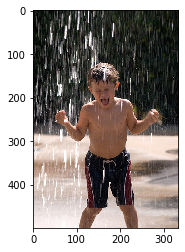

lstm ['A', 'little', 'boy', 'is', 'running', 'through', 'a', 'sprinkler', 'in', 'a', 'pool', '.']
knn ['many', 'children', 'play', 'in', 'the', 'water', '.']
['many', 'children', 'play', 'in', 'the', 'water', '.']
1
_____________________________________



  0%|                                                                                | 1/970 [00:04<1:12:37,  4.50s/it]

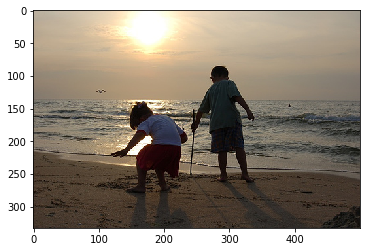

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'dog', 'are', 'walking', 'along', 'a', 'beach', '.']
knn ['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
2
_____________________________________



  0%|▏                                                                               | 2/970 [00:08<1:12:00,  4.46s/it]

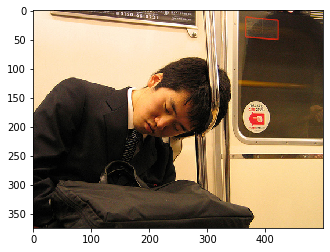

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'sitting', 'on', 'a', 'bench', 'reading', 'a', 'book', '.']
knn ['A', 'man', 'in', 'a', 'black', 'jacket', 'is', 'in', 'front', 'of', 'a', 'map', '.']
['A', 'man', 'and', 'a', 'woman', 'sitting', 'on', 'a', 'bench', 'reading', 'a', 'book', '.']
3
_____________________________________



  0%|▏                                                                               | 3/970 [00:13<1:14:35,  4.63s/it]

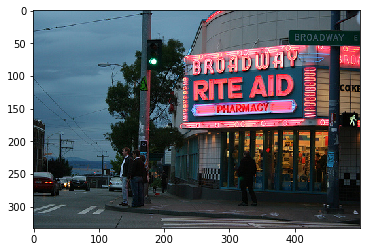

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
knn ['A', 'group', 'of', 'people', 'on', 'the', 'sidewalk', 'of', 'a', 'city', 'street', '.']
['A', 'group', 'of', 'people', 'on', 'the', 'sidewalk', 'of', 'a', 'city', 'street', '.']
4
_____________________________________



  0%|▎                                                                               | 4/970 [00:18<1:15:43,  4.70s/it]

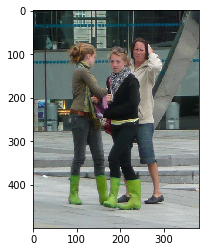

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'walking', 'down', 'the', 'street', '.']
knn ['A', 'woman', 'in', 'a', 'black', 'jacket', 'and', 'black', 'and', 'white', 'skirt', 'walks', 'down', 'the', 'street', '.']
['A', 'group', 'of', 'people', 'walking', 'down', 'the', 'street', '.']
5
_____________________________________



  1%|▍                                                                               | 5/970 [00:23<1:13:40,  4.58s/it]

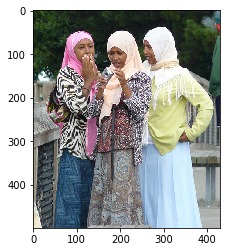

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
knn ['A', 'little', 'girl', 'in', 'a', 'yellow', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'restaurant', '.']
['A', 'woman', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
6
_____________________________________



  1%|▍                                                                               | 6/970 [00:28<1:16:15,  4.75s/it]

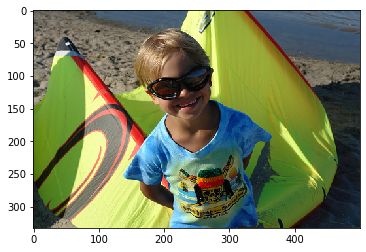

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'fountain', 'in', 'the', 'snow', '.']
knn ['A', 'group', 'of', 'people', 'launch', 'an', 'air', 'rocket', 'in', 'front', 'of', 'a', 'marina', '.']
['A', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'fountain', 'in', 'the', 'snow', '.']
7
_____________________________________



  1%|▌                                                                               | 7/970 [00:33<1:16:29,  4.77s/it]

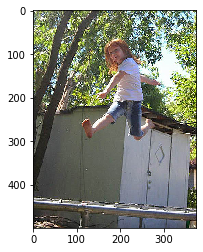

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'red', 'shirt', 'and', 'blue', 'jeans', 'is', 'climbing', 'a', 'rock', 'wall', '.']
knn ['A', 'toddler', 'in', 'green', 'shorts', 'is', 'standing', 'by', 'a', 'wooden', 'fence', '.']
['A', 'boy', 'in', 'a', 'red', 'shirt', 'and', 'blue', 'jeans', 'is', 'climbing', 'a', 'rock', 'wall', '.']
8
_____________________________________



  1%|▋                                                                               | 8/970 [00:37<1:16:49,  4.79s/it]

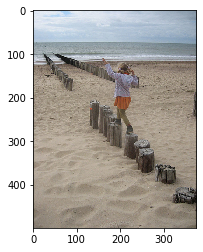

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'sit', 'on', 'the', 'edge', 'of', 'a', 'river', '.']
knn ['A', 'dog', 'is', 'running', 'on', 'the', 'beach', '.']
['A', 'dog', 'is', 'running', 'on', 'the', 'beach', '.']
9
_____________________________________



  1%|▋                                                                               | 9/970 [00:42<1:18:08,  4.88s/it]

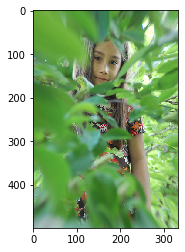

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'on', 'the', 'grass', '.']
knn ['A', 'little', 'brown', 'dog', 'is', 'running', 'in', 'a', 'field', '.']
['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'on', 'the', 'grass', '.']
10
_____________________________________



  1%|▊                                                                              | 10/970 [00:47<1:17:12,  4.83s/it]

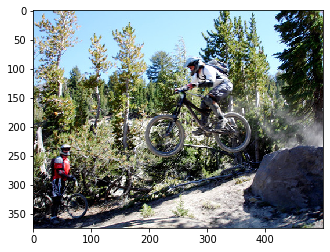

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'mountain', 'biker', 'rides', 'through', 'the', 'woods', '.']
knn ['A', 'man', 'riding', 'a', 'bike', 'down', 'a', 'hill', '.']
['A', 'mountain', 'biker', 'rides', 'through', 'the', 'woods', '.']
11
_____________________________________



  1%|▉                                                                              | 11/970 [00:51<1:13:20,  4.59s/it]

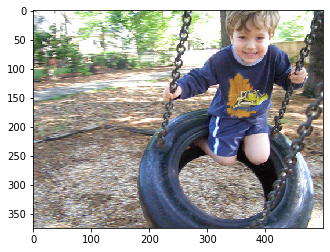

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'swings', 'on', 'a', 'swing', '.']
knn ['A', 'blonde', 'child', 'swinging', 'on', 'a', 'swing', '.']
['A', 'blonde', 'child', 'swinging', 'on', 'a', 'swing', '.']
12
_____________________________________



  1%|▉                                                                              | 12/970 [00:55<1:10:19,  4.40s/it]

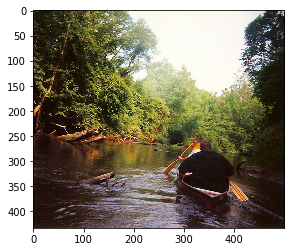

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'people', 'are', 'sitting', 'on', 'a', 'dock', 'in', 'the', 'water', '.']
knn ['The', 'brown', 'dog', 'is', 'swimming', 'in', 'the', 'water', '.']
['The', 'brown', 'dog', 'is', 'swimming', 'in', 'the', 'water', '.']
13
_____________________________________



  1%|█                                                                              | 13/970 [00:59<1:08:47,  4.31s/it]

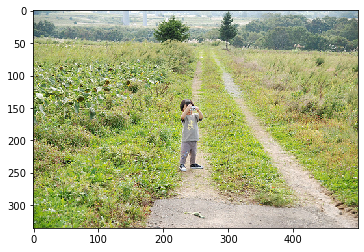

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'grassy', 'hill', 'with', 'a', 'tree', 'in', 'the', 'background', '.']
knn ['A', 'man', 'in', 'a', 'green', 'hat', 'standing', 'on', 'a', 'slope', 'in', 'front', 'of', 'a', 'mountain', '.']
['A', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'grassy', 'hill', 'with', 'a', 'tree', 'in', 'the', 'background', '.']
14
_____________________________________



  1%|█▏                                                                             | 14/970 [01:04<1:10:14,  4.41s/it]

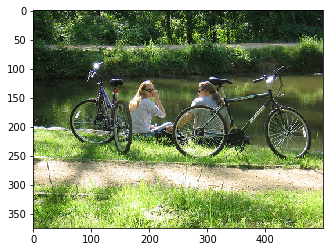

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'riding', 'a', 'bicycle', 'down', 'a', 'hill', '.']
knn ['A', 'man', 'on', 'a', 'bicycle', 'is', 'jumping', 'over', 'a', 'sign', 'that', 'says', '"', 'free', 'dinner', '"', '.']
['A', 'man', 'is', 'riding', 'a', 'bicycle', 'down', 'a', 'hill', '.']
15
_____________________________________



  2%|█▏                                                                             | 15/970 [01:08<1:09:44,  4.38s/it]

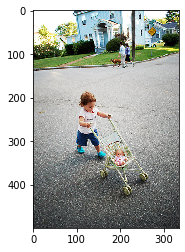

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'red', 'dress', 'is', 'running', 'on', 'the', 'grass', '.']
knn ['A', 'little', 'girl', 'in', 'a', 'dress', 'playing', 'with', 'a', 'soccer', 'ball', '.']
['A', 'little', 'girl', 'in', 'a', 'red', 'dress', 'is', 'running', 'on', 'the', 'grass', '.']
16
_____________________________________



  2%|█▎                                                                             | 16/970 [01:13<1:10:27,  4.43s/it]

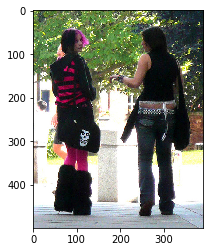

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'girl', 'in', 'a', 'pink', 'dress', 'walks', 'down', 'the', 'street', '.']
knn ['A', 'woman', 'in', 'a', 'black', 'shirt', 'sitting', 'on', 'a', 'red', 'bench', '.']
['A', 'girl', 'in', 'a', 'pink', 'dress', 'walks', 'down', 'the', 'street', '.']
17
_____________________________________



  2%|█▍                                                                             | 17/970 [01:17<1:10:30,  4.44s/it]

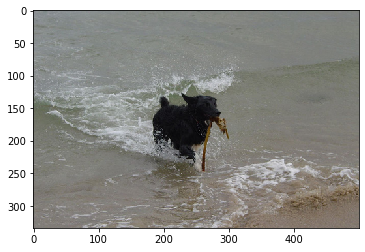

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
knn ['The', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
['The', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
18
_____________________________________



  2%|█▍                                                                             | 18/970 [01:21<1:09:38,  4.39s/it]

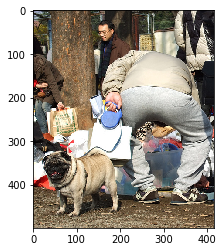

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', '.']
knn ['Two', 'dogs', 'play', 'with', 'a', 'tennis', 'ball', 'in', 'the', 'snow', '.']
['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', '.']
19
_____________________________________



  2%|█▌                                                                             | 19/970 [01:27<1:13:24,  4.63s/it]

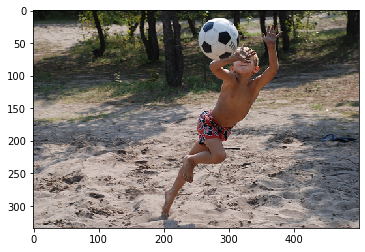

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'playing', 'with', 'a', 'soccer', 'ball', 'in', 'a', 'grassy', 'field', '.']
knn ['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
20
_____________________________________



  2%|█▋                                                                             | 20/970 [01:32<1:14:33,  4.71s/it]

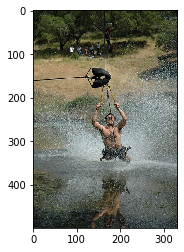

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'jumping', 'into', 'a', 'lake', '.']
knn ['A', 'woman', 'is', 'sitting', 'on', 'a', 'rock', 'next', 'to', 'a', 'large', 'waterfall', '.']
['A', 'man', 'is', 'jumping', 'into', 'a', 'lake', '.']
21
_____________________________________



  2%|█▋                                                                             | 21/970 [01:36<1:12:19,  4.57s/it]

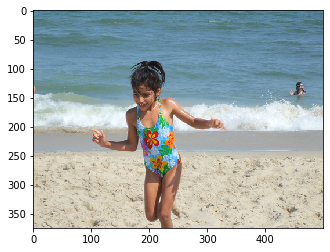

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'bathing', 'suit', 'is', 'jumping', 'into', 'the', 'water', '.']
knn ['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
22
_____________________________________



  2%|█▊                                                                             | 22/970 [01:41<1:12:56,  4.62s/it]

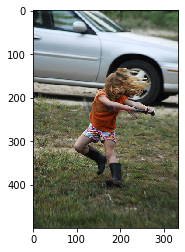

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'running', 'on', 'the', 'grass', '.']
knn ['Two', 'dogs', 'are', 'running', 'in', 'a', 'grassy', 'field', '.']
['Two', 'dogs', 'are', 'running', 'in', 'a', 'grassy', 'field', '.']
23
_____________________________________



  2%|█▊                                                                             | 23/970 [01:45<1:13:42,  4.67s/it]

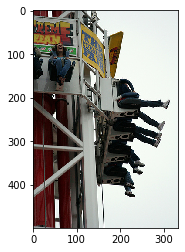

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'red', 'building', '.']
knn ['A', 'man', 'doing', 'a', 'back', 'flip', 'off', 'a', 'box']
['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'red', 'building', '.']
24
_____________________________________



  2%|█▉                                                                             | 24/970 [01:50<1:13:59,  4.69s/it]

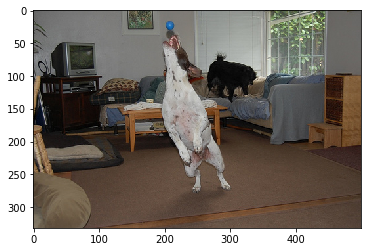

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'staring', 'at', 'two', 'brown', 'lambs', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
25
_____________________________________



  3%|██                                                                             | 25/970 [01:54<1:12:22,  4.59s/it]

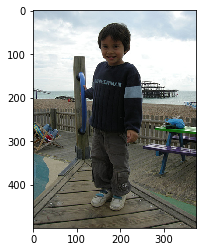

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'standing', 'next', 'to', 'a', 'picnic', 'table', '.']
knn ['A', 'girl', 'is', 'taking', 'a', 'picture', 'of', 'another', 'girl', 'in', 'a', 'park', '.']
['A', 'girl', 'is', 'taking', 'a', 'picture', 'of', 'another', 'girl', 'in', 'a', 'park', '.']
26
_____________________________________



  3%|██                                                                             | 26/970 [02:00<1:15:06,  4.77s/it]

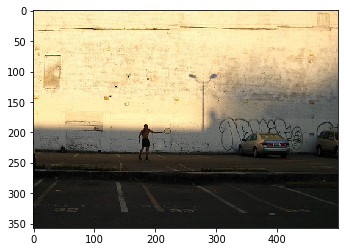

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
knn ['A', 'group', 'of', 'people', 'stand', 'in', 'front', 'of', 'a', 'large', 'apartment', 'building', '.']
['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
27
_____________________________________



  3%|██▏                                                                            | 27/970 [02:04<1:14:51,  4.76s/it]

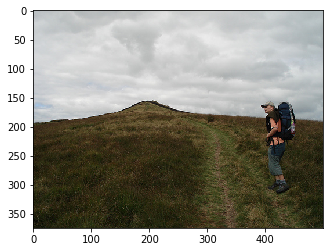

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'khaki', 'pants', 'stands', 'on', 'a', 'rock', 'overlooking', 'a', 'valley', '.']
knn ['There', 'are', 'two', 'people', 'with', 'backpacks', 'walking', 'on', 'the', 'side', 'of', 'a', 'grassy', 'hill', '.']
['There', 'are', 'two', 'people', 'with', 'backpacks', 'walking', 'on', 'the', 'side', 'of', 'a', 'grassy', 'hill', '.']
28
_____________________________________



  3%|██▎                                                                            | 28/970 [02:09<1:16:14,  4.86s/it]

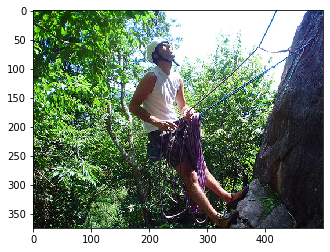

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'climbing', 'a', 'tree', 'branch', '.']
knn ['A', 'little', 'girl', 'squats', 'on', 'a', 'tree', 'stump', 'in', 'the', 'woods', '.']
['A', 'young', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'climbing', 'a', 'tree', 'branch', '.']
29
_____________________________________



  3%|██▎                                                                            | 29/970 [02:14<1:15:40,  4.83s/it]

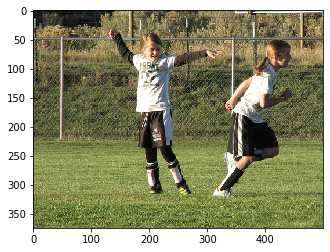

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'red', 'and', 'white', 'uniform', 'is', 'running', 'in', 'a', 'field', '.']
knn ['Three', 'boys', 'playing', 'soccer', '.']
['Three', 'boys', 'playing', 'soccer', '.']
30
_____________________________________



  3%|██▍                                                                            | 30/970 [02:19<1:16:01,  4.85s/it]

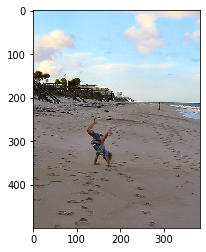

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'people', 'are', 'walking', 'along', 'the', 'beach', 'along', 'the', 'ocean', '.']
knn ['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
31
_____________________________________



  3%|██▌                                                                            | 31/970 [02:23<1:12:09,  4.61s/it]

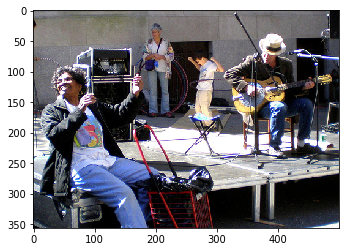

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'white', 'building', '.']
knn ['A', 'man', 'in', 'a', 'pink', 'shirt', 'and', 'white', 'vest', 'plays', 'a', 'guitar', '.']
['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'white', 'building', '.']
32
_____________________________________



  3%|██▌                                                                            | 32/970 [02:28<1:13:17,  4.69s/it]

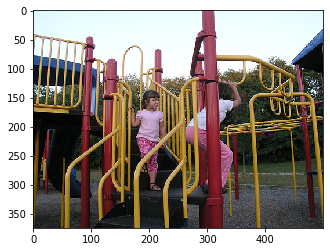

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'hula', 'hoop', '.']
knn ['Children', 'playing', 'on', 'a', 'playground', '.']
['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'hula', 'hoop', '.']
33
_____________________________________



  3%|██▋                                                                            | 33/970 [02:33<1:13:36,  4.71s/it]

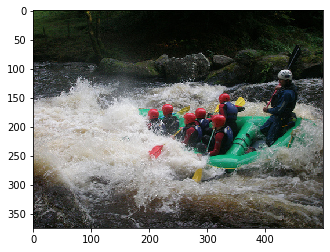

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'sitting', 'in', 'a', 'kayak', 'in', 'the', 'water', '.']
knn ['A', 'man', 'in', 'a', 'yellow', 'kayak', 'riding', 'through', 'rapids', '.']
['A', 'man', 'in', 'a', 'yellow', 'kayak', 'riding', 'through', 'rapids', '.']
34
_____________________________________



  4%|██▊                                                                            | 34/970 [02:37<1:13:19,  4.70s/it]

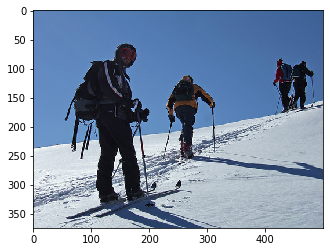

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'skiing', 'down', 'a', 'snowy', 'hill', '.']
knn ['Two', 'kids', 'play', 'hockey', 'in', 'the', 'snow', '.']
['Two', 'kids', 'play', 'hockey', 'in', 'the', 'snow', '.']
35
_____________________________________



  4%|██▊                                                                            | 35/970 [02:42<1:12:16,  4.64s/it]

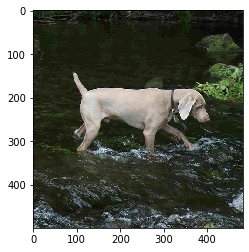

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'brown', 'dog', 'is', 'running', 'through', 'the', 'water', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.']
knn ['A', 'brown', 'dog', 'is', 'climbing', 'out', 'of', 'the', 'water', 'with', 'a', 'green', 'ball', 'in', 'its', 'mouth', '.']
['A', 'brown', 'dog', 'is', 'running', 'through', 'the', 'water', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.']
36
_____________________________________



  4%|██▉                                                                            | 36/970 [02:47<1:13:06,  4.70s/it]

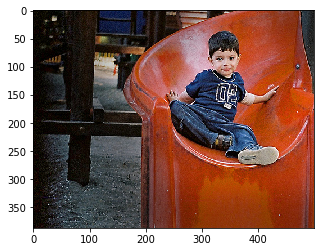

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'blue', 'shirt', 'is', 'walking', 'past', 'a', 'parking', 'lot', '.']
knn ['A', 'man', 'in', 'a', 'wetsuit', 'and', 'helmet', 'in', 'front', 'of', 'a', 'red', 'wall', '.']
['A', 'woman', 'in', 'a', 'blue', 'shirt', 'is', 'walking', 'past', 'a', 'parking', 'lot', '.']
37
_____________________________________



  4%|███                                                                            | 37/970 [02:52<1:13:08,  4.70s/it]

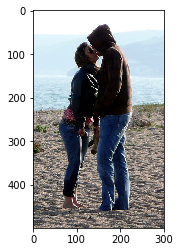

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'walk', 'on', 'the', 'beach', '.']
knn ['A', 'man', 'wearing', 'a', 'black', 'shirt', 'is', 'standing', 'on', 'top', 'of', 'a', 'rock', 'that', 'says', ',', '"', 'life', 'is', 'short', '"', '.']
['A', 'man', 'and', 'a', 'woman', 'walk', 'on', 'the', 'beach', '.']
38
_____________________________________



  4%|███                                                                            | 38/970 [02:56<1:12:12,  4.65s/it]

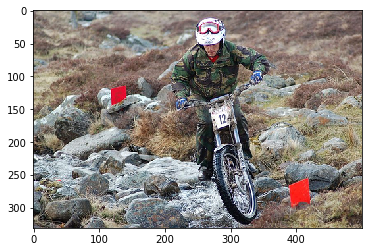

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'riding', 'a', 'bike', 'through', 'the', 'woods', '.']
knn ['Three', 'people', 'are', 'posing', 'on', 'the', 'side', 'of', 'a', 'mountain', '.']
['Three', 'people', 'are', 'posing', 'on', 'the', 'side', 'of', 'a', 'mountain', '.']
39
_____________________________________



  4%|███▏                                                                           | 39/970 [03:01<1:11:58,  4.64s/it]

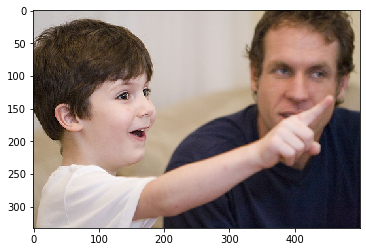

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'boy', 'with', 'a', 'blue', 'headband', 'is', 'eating', 'a', 'snack', '.']
knn ['A', 'man', 'and', 'a', 'woman', 'smiling', 'for', 'the', 'camera', '.']
['A', 'man', 'and', 'a', 'woman', 'smiling', 'for', 'the', 'camera', '.']
40
_____________________________________



  4%|███▎                                                                           | 40/970 [03:06<1:13:16,  4.73s/it]

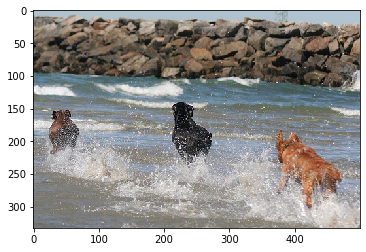

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'dogs', 'play', 'in', 'the', 'water', '.']
knn ['Two', 'dogs', 'play', 'in', 'the', 'water', '.']
['Two', 'dogs', 'play', 'in', 'the', 'water', '.']
41
_____________________________________



  4%|███▎                                                                           | 41/970 [03:09<1:08:28,  4.42s/it]

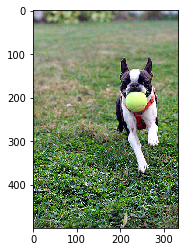

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'on', 'the', 'grass', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
42
_____________________________________



  4%|███▍                                                                           | 42/970 [03:14<1:07:59,  4.40s/it]

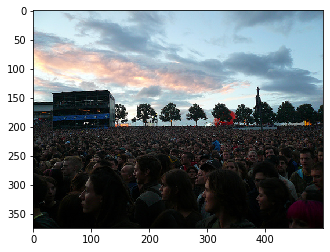

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'gathered', 'around', 'a', 'building', '.']
knn ['A', 'group', 'of', 'people', 'are', 'gathered', 'together', '.']
['A', 'group', 'of', 'people', 'are', 'gathered', 'around', 'a', 'building', '.']
43
_____________________________________



  4%|███▌                                                                           | 43/970 [03:18<1:07:23,  4.36s/it]

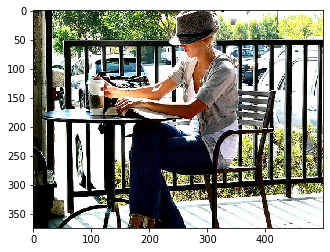

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'building', '.']
knn ['A', 'man', 'in', 'a', 'hat', 'and', 'sunglasses', 'reads', 'a', 'book', 'on', 'a', 'park', 'bench', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', 'in', 'front', 'of', 'a', 'building', '.']
44
_____________________________________



  5%|███▌                                                                           | 44/970 [03:23<1:08:56,  4.47s/it]

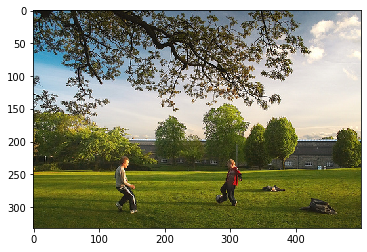

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'running', 'on', 'the', 'grass', 'with', 'a', 'green', 'ball', 'in', 'his', 'hand', '.']
knn ['A', 'woman', 'is', 'running', 'with', 'a', 'dog', 'in', 'a', 'grassy', 'field', 'with', 'trees', 'in', 'the', 'background', '.']
['A', 'woman', 'is', 'running', 'with', 'a', 'dog', 'in', 'a', 'grassy', 'field', 'with', 'trees', 'in', 'the', 'background', '.']
45
_____________________________________



  5%|███▋                                                                           | 45/970 [03:27<1:09:43,  4.52s/it]

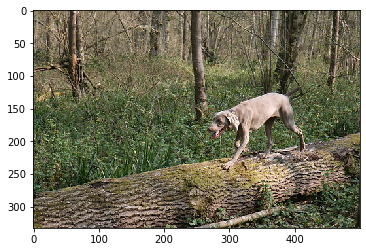

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'brown', 'dog', 'is', 'running', 'through', 'a', 'wooded', 'area', '.']
knn ['The', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass', 'with', 'a', 'yellow', 'toy', 'in', 'its', 'mouth', '.']
['A', 'brown', 'dog', 'is', 'running', 'through', 'a', 'wooded', 'area', '.']
46
_____________________________________



  5%|███▋                                                                           | 46/970 [03:32<1:09:17,  4.50s/it]

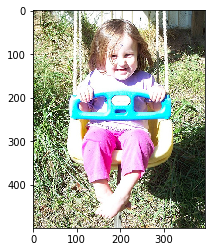

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'swinging', 'on', 'a', 'swing', '.']
knn ['A', 'young', 'boy', 'plays', 'on', 'a', 'swing', '.']
['A', 'young', 'boy', 'plays', 'on', 'a', 'swing', '.']
47
_____________________________________



  5%|███▊                                                                           | 47/970 [03:36<1:06:53,  4.35s/it]

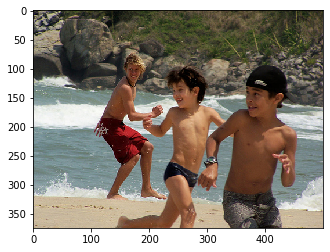

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'bathing', 'suit', 'is', 'jumping', 'into', 'the', 'water', '.']
knn ['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
48
_____________________________________



  5%|███▉                                                                           | 48/970 [03:40<1:08:27,  4.45s/it]

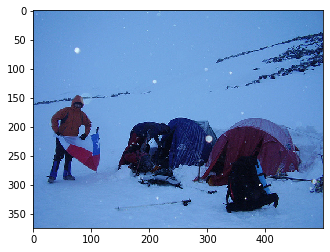

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'walking', 'through', 'a', 'snow', 'covered', 'field', '.']
knn ['Two', 'kids', 'and', 'a', 'dog', 'play', 'in', 'the', 'snow', '.']
['Two', 'kids', 'and', 'a', 'dog', 'play', 'in', 'the', 'snow', '.']
49
_____________________________________



  5%|███▉                                                                           | 49/970 [03:45<1:07:46,  4.41s/it]

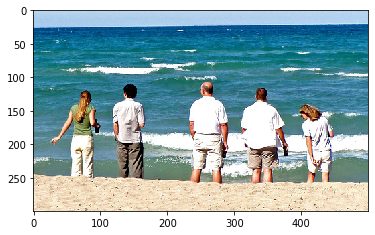

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'walking', 'along', 'a', 'beach', '.']
knn ['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
50
_____________________________________



  5%|████                                                                           | 50/970 [03:49<1:08:48,  4.49s/it]

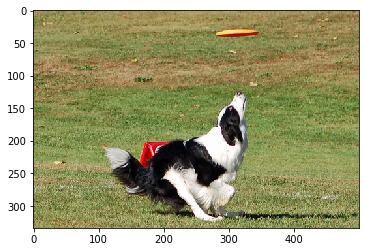

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
51
_____________________________________



  5%|████▏                                                                          | 51/970 [03:54<1:08:33,  4.48s/it]

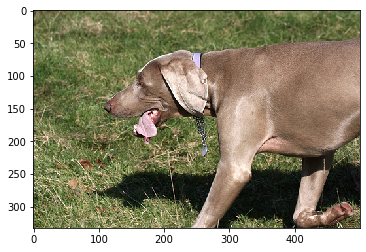

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'brown', 'dog', 'is', 'licking', 'its', 'nose', 'while', 'standing', 'in', 'a', 'field', 'of', 'grass', '.']
knn ['The', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass', 'with', 'a', 'yellow', 'toy', 'in', 'its', 'mouth', '.']
['A', 'brown', 'dog', 'is', 'licking', 'its', 'nose', 'while', 'standing', 'in', 'a', 'field', 'of', 'grass', '.']
52
_____________________________________



  5%|████▏                                                                          | 52/970 [03:59<1:09:17,  4.53s/it]

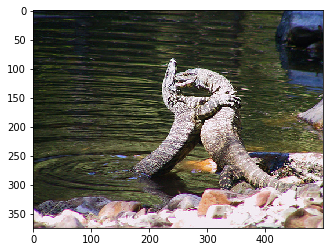

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'dog', 'swims', 'in', 'the', 'water', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.']
knn ['The', 'dog', 'is', 'swimming', 'in', 'the', 'water', '.']
['A', 'dog', 'swims', 'in', 'the', 'water', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.']
53
_____________________________________



  5%|████▎                                                                          | 53/970 [04:03<1:07:27,  4.41s/it]

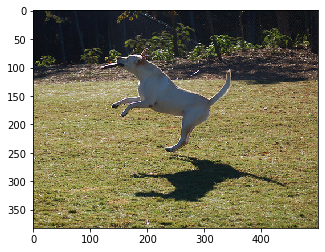

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'white', 'dog', 'and', 'a', 'brown', 'dog', 'are', 'playing', 'with', 'a', 'ball', 'in', 'the', 'grass', '.']
knn ['A', 'white', 'dog', 'carries', 'a', 'white', 'ball', 'in', 'its', 'mouth', '.']
['A', 'white', 'dog', 'carries', 'a', 'white', 'ball', 'in', 'its', 'mouth', '.']
54
_____________________________________



  6%|████▍                                                                          | 54/970 [04:07<1:08:42,  4.50s/it]

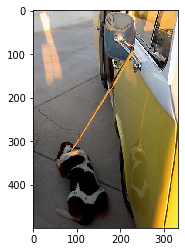

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', 'with', 'a', 'dog', '.']
knn ['A', 'young', 'boy', 'is', 'draping', 'a', 'toy', 'over', 'a', 'young', 'girl', 'on', 'a', 'skateboard', '.']
['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', 'with', 'a', 'dog', '.']
55
_____________________________________



  6%|████▍                                                                          | 55/970 [04:12<1:10:51,  4.65s/it]

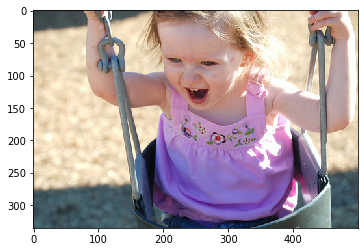

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'swinging', 'on', 'a', 'swing', '.']
knn ['A', 'blonde', 'child', 'swinging', 'on', 'a', 'swing', '.']
['A', 'blonde', 'child', 'swinging', 'on', 'a', 'swing', '.']
56
_____________________________________



  6%|████▌                                                                          | 56/970 [04:17<1:10:19,  4.62s/it]

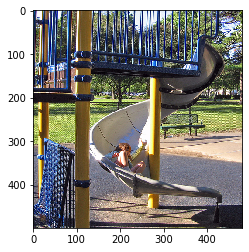

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'skateboarding', 'on', 'a', 'rail', '.']
knn ['The', 'boy', 'is', 'jumping', 'off', 'a', 'high', 'diving', 'board', 'into', 'the', 'pool', '.']
['A', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'skateboarding', 'on', 'a', 'rail', '.']
57
_____________________________________



  6%|████▋                                                                          | 57/970 [04:21<1:09:26,  4.56s/it]

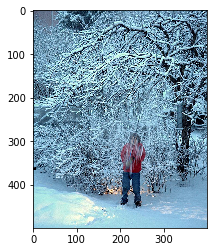

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'walking', 'through', 'the', 'woods', '.']
knn ['Two', 'kids', 'and', 'a', 'dog', 'play', 'in', 'the', 'snow', '.']
['Two', 'kids', 'and', 'a', 'dog', 'play', 'in', 'the', 'snow', '.']
58
_____________________________________



  6%|████▋                                                                          | 58/970 [04:26<1:08:50,  4.53s/it]

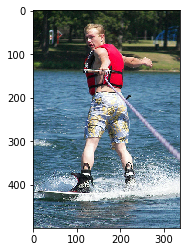

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'pink', 'bathing', 'suit', 'is', 'jumping', 'into', 'a', 'swimming', 'pool', '.']
knn ['A', 'man', 'wearing', 'a', 'black', 'wetsuit', 'is', 'surfing', 'in', 'the', 'water', '.']
['A', 'young', 'girl', 'in', 'a', 'pink', 'bathing', 'suit', 'is', 'jumping', 'into', 'a', 'swimming', 'pool', '.']
59
_____________________________________



  6%|████▊                                                                          | 59/970 [04:30<1:09:07,  4.55s/it]

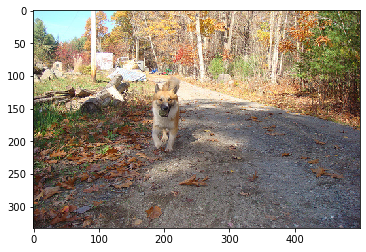

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'brown', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.']
knn ['Two', 'dogs', 'are', 'running', 'in', 'a', 'grassy', 'field', '.']
['Two', 'dogs', 'are', 'running', 'in', 'a', 'grassy', 'field', '.']
60
_____________________________________



  6%|████▉                                                                          | 60/970 [04:34<1:06:12,  4.37s/it]

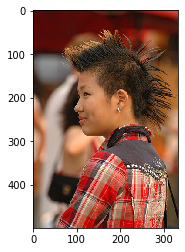

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'flag', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
knn ['A', 'man', 'in', 'a', 'red', 'jacket', 'and', 'hat', 'talks', 'to', 'another', 'man', '.']
['A', 'woman', 'in', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'flag', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
61
_____________________________________



  6%|████▉                                                                          | 61/970 [04:39<1:09:38,  4.60s/it]

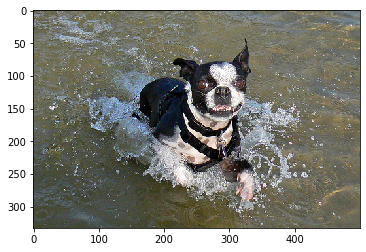

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
knn ['The', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
['The', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'water', '.']
62
_____________________________________



  6%|█████                                                                          | 62/970 [04:44<1:08:32,  4.53s/it]

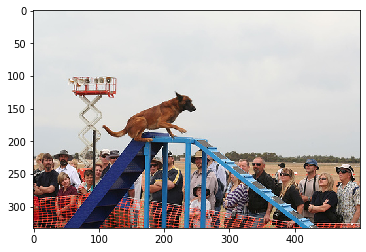

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'brown', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
knn ['Three', 'men', 'walking', 'in', 'front', 'of', 'a', 'colorful', 'tent', 'with', 'a', 'sign', 'on', 'it', '.']
['A', 'brown', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
63
_____________________________________



  6%|█████▏                                                                         | 63/970 [04:48<1:06:42,  4.41s/it]

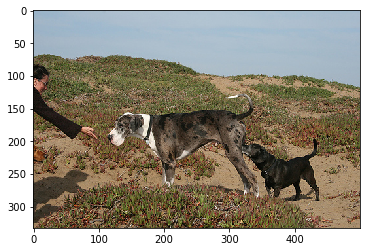

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'field', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
64
_____________________________________



  7%|█████▏                                                                         | 64/970 [04:52<1:05:16,  4.32s/it]

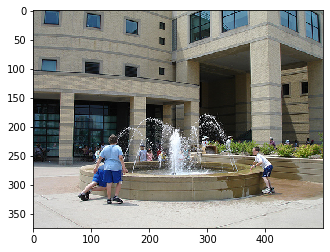

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'fountain', '.']
knn ['A', 'man', 'posing', 'in', 'front', 'of', 'a', 'crowd', 'on', 'a', 'busy', 'street', '.']
['A', 'man', 'posing', 'in', 'front', 'of', 'a', 'crowd', 'on', 'a', 'busy', 'street', '.']
65
_____________________________________



  7%|█████▎                                                                         | 65/970 [04:57<1:07:19,  4.46s/it]

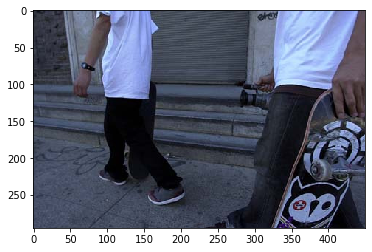

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
knn ['A', 'man', 'in', 'a', 'black', 'jacket', 'and', 'jeans', 'stands', 'in', 'front', 'of', 'a', 'brick', 'wall', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
66
_____________________________________



  7%|█████▍                                                                         | 66/970 [05:02<1:08:09,  4.52s/it]

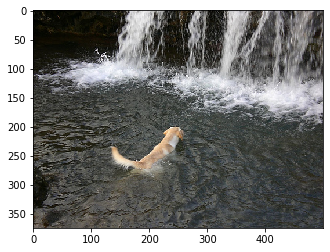

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'dog', 'is', 'jumping', 'into', 'the', 'water', 'at', 'the', 'beach', '.']
knn ['A', 'man', 'is', 'surfing', 'a', 'large', 'wave', 'in', 'the', 'ocean', '.']
['A', 'man', 'is', 'surfing', 'a', 'large', 'wave', 'in', 'the', 'ocean', '.']
67
_____________________________________



  7%|█████▍                                                                         | 67/970 [05:05<1:05:23,  4.35s/it]

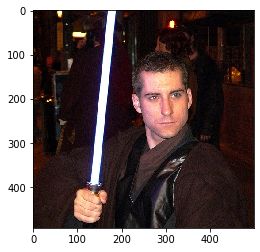

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'red', 'shirt', '.']
knn ['A', 'man', 'and', 'woman', 'pose', 'for', 'a', 'picture', 'together', '.']
['A', 'man', 'and', 'woman', 'pose', 'for', 'a', 'picture', 'together', '.']
68
_____________________________________



  7%|█████▌                                                                         | 68/970 [05:11<1:09:04,  4.59s/it]

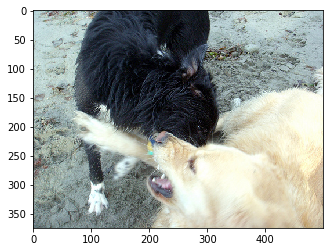

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'dog', 'and', 'a', 'black', 'dog', 'are', 'playing', 'tug', 'of', 'war', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'area', '.']
69
_____________________________________



  7%|█████▌                                                                         | 69/970 [05:16<1:10:16,  4.68s/it]

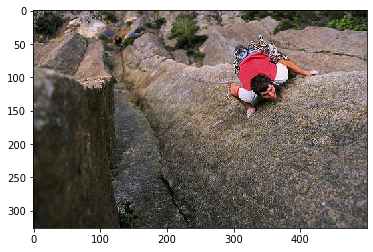

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'rock', 'climbing', '.']
knn ['A', 'girl', 'in', 'a', 'red', 'shirt', 'is', 'rock', 'climbing', '.']
['A', 'man', 'is', 'rock', 'climbing', '.']
70
_____________________________________



  7%|█████▋                                                                         | 70/970 [05:20<1:09:31,  4.63s/it]

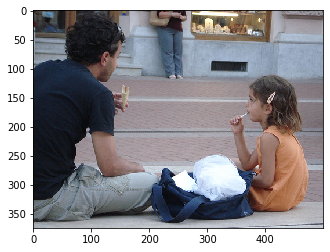

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'children', 'are', 'sitting', 'on', 'a', 'wooden', 'floor', 'in', 'a', 'mall', '.']
knn ['A', 'man', 'wearing', 'a', 'multi-color', 'coat', 'is', 'playing', 'the', 'guitar', 'on', 'the', 'street', '.']
['A', 'group', 'of', 'children', 'are', 'sitting', 'on', 'a', 'wooden', 'floor', 'in', 'a', 'mall', '.']
71
_____________________________________



  7%|█████▊                                                                         | 71/970 [05:25<1:10:13,  4.69s/it]

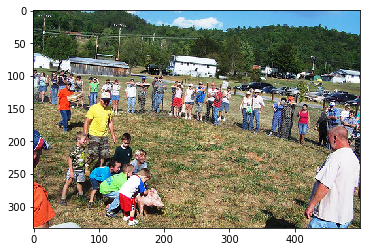

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'large', 'building', '.']
knn ['A', 'group', 'of', 'people', 'stands', 'by', 'their', 'dogs', 'in', 'a', 'field', '.']
['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'large', 'building', '.']
72
_____________________________________



  7%|█████▊                                                                         | 72/970 [05:30<1:10:13,  4.69s/it]

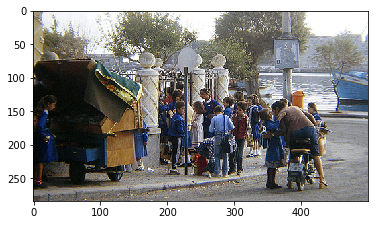

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
knn ['A', 'group', 'of', 'people', 'stand', 'in', 'front', 'of', 'a', 'large', 'apartment', 'building', '.']
['A', 'group', 'of', 'people', 'stand', 'in', 'front', 'of', 'a', 'large', 'apartment', 'building', '.']
73
_____________________________________



  8%|█████▉                                                                         | 73/970 [05:35<1:11:22,  4.77s/it]

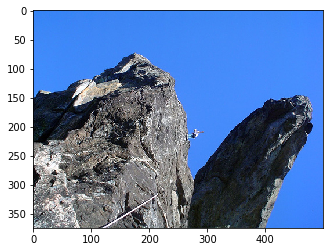

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'rock', 'climbing', '.']
knn ['A', 'white', 'dog', 'is', 'walking', 'on', 'top', 'of', 'a', 'mountain', '.']
['A', 'man', 'is', 'rock', 'climbing', '.']
74
_____________________________________



  8%|██████                                                                         | 74/970 [05:39<1:08:54,  4.61s/it]

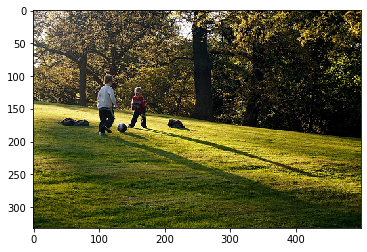

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'running', 'on', 'the', 'grass', 'carrying', 'a', 'ball', 'in', 'his', 'hand', '.']
knn ['A', 'woman', 'is', 'running', 'with', 'a', 'dog', 'in', 'a', 'grassy', 'field', 'with', 'trees', 'in', 'the', 'background', '.']
['A', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'running', 'on', 'the', 'grass', 'carrying', 'a', 'ball', 'in', 'his', 'hand', '.']
75
_____________________________________



  8%|██████                                                                         | 75/970 [05:45<1:16:00,  5.10s/it]

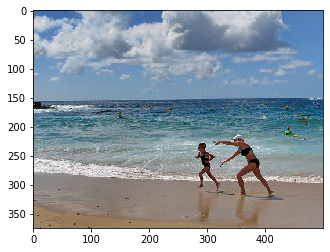

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'pink', 'bathing', 'suit', 'plays', 'in', 'the', 'sand', '.']
knn ['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
['A', 'boy', 'jumping', 'in', 'the', 'air', 'on', 'the', 'beach', '.']
76
_____________________________________



  8%|██████▏                                                                        | 76/970 [05:49<1:13:12,  4.91s/it]

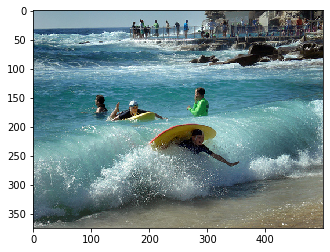

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'black', 'wetsuit', 'surfs', 'in', 'the', 'ocean', '.']
knn ['A', 'boy', 'is', 'surfing', 'in', 'the', 'ocean', '.']
['A', 'boy', 'is', 'surfing', 'in', 'the', 'ocean', '.']
77
_____________________________________



  8%|██████▎                                                                        | 77/970 [05:54<1:10:37,  4.75s/it]

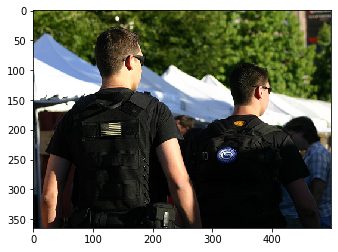

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'who', 'is', 'holding', 'a', 'bottle', 'of', 'water', '.']
knn ['A', 'man', 'in', 'a', 'uniform', 'smiling', 'and', 'waving', 'at', 'the', 'camera', '.']
['A', 'man', 'in', 'a', 'uniform', 'smiling', 'and', 'waving', 'at', 'the', 'camera', '.']
78
_____________________________________



  8%|██████▎                                                                        | 78/970 [05:59<1:13:06,  4.92s/it]

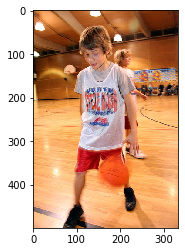

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'basketball', '.']
knn ['A', 'basketball', 'player', 'wearing', 'a', 'white', 'uniform', 'is', 'dribbling', 'the', 'ball', 'on', 'the', 'court', '.']
['A', 'little', 'boy', 'in', 'a', 'blue', 'shirt', 'is', 'playing', 'with', 'a', 'basketball', '.']
79
_____________________________________



  8%|██████▍                                                                        | 79/970 [06:04<1:11:13,  4.80s/it]

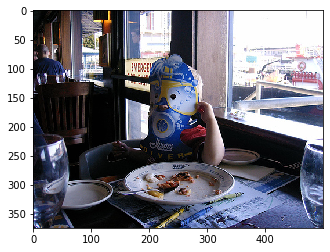

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', 'with', 'a', 'bug', '.']
knn ['A', 'man', 'and', 'a', 'woman', 'looking', 'at', 'the', 'camera', '.']
['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', 'with', 'a', 'bug', '.']
80
_____________________________________



  8%|██████▌                                                                        | 80/970 [06:08<1:11:07,  4.79s/it]

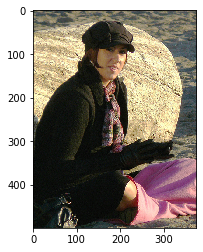

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'rock', 'overlooking', 'a', 'lake', '.']
knn ['A', 'little', 'girl', 'in', 'a', 'pink', 'jacket', 'is', 'walking', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'rock', 'overlooking', 'a', 'lake', '.']
81
_____________________________________



  8%|██████▌                                                                        | 81/970 [06:13<1:11:01,  4.79s/it]

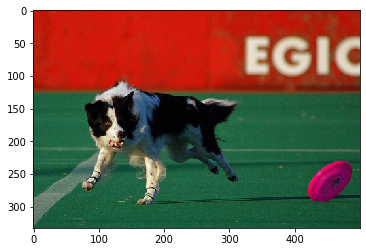

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'catches', 'a', 'frisbee', 'in', 'midair', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
82
_____________________________________



  8%|██████▋                                                                        | 82/970 [06:18<1:09:14,  4.68s/it]

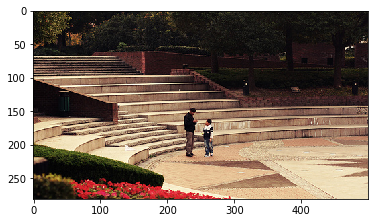

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'standing', 'on', 'a', 'bench', '.']
knn ['A', 'skateboarder', 'slides', 'down', 'a', 'handrail', '.']
['A', 'skateboarder', 'slides', 'down', 'a', 'handrail', '.']
83
_____________________________________



  9%|██████▊                                                                        | 83/970 [06:23<1:10:40,  4.78s/it]

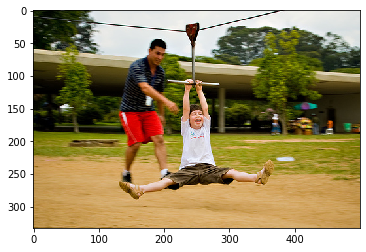

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'red', 'uniform', 'kicks', 'a', 'soccer', 'ball', 'on', 'the', 'grass', '.']
knn ['A', 'woman', 'in', 'a', 'white', 'tennis', 'outfit', 'has', 'jumped', 'into', 'the', 'air', 'to', 'hit', 'a', 'tennis', 'ball', '.']
['A', 'boy', 'in', 'a', 'red', 'uniform', 'kicks', 'a', 'soccer', 'ball', 'on', 'the', 'grass', '.']
84
_____________________________________



  9%|██████▊                                                                        | 84/970 [06:27<1:09:34,  4.71s/it]

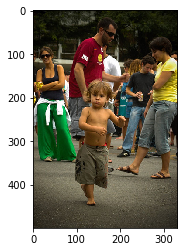

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'running', 'through', 'a', 'parking', 'lot', '.']
knn ['A', 'girl', 'is', 'taking', 'a', 'picture', 'of', 'another', 'girl', 'in', 'a', 'park', '.']
['A', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'running', 'through', 'a', 'parking', 'lot', '.']
85
_____________________________________



  9%|██████▉                                                                        | 85/970 [06:32<1:08:46,  4.66s/it]

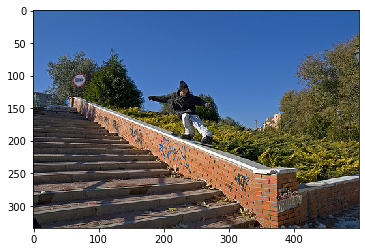

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'standing', 'on', 'a', 'wooden', 'bench', '.']
knn ['Three', 'children', 'are', 'sitting', 'at', 'the', 'top', 'of', 'a', 'flight', 'of', 'steps', '.']
['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'standing', 'on', 'a', 'wooden', 'bench', '.']
86
_____________________________________



  9%|███████                                                                        | 86/970 [06:37<1:10:48,  4.81s/it]

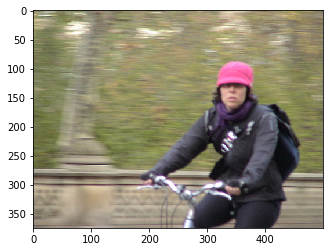

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'wearing', 'a', 'helmet', 'rides', 'a', 'bike', 'through', 'the', 'woods', '.']
knn ['A', 'woman', 'in', 'a', 'winter', 'coat', 'riding', 'a', 'bike', 'down', 'a', 'city', 'street', '.']
['A', 'man', 'wearing', 'a', 'helmet', 'rides', 'a', 'bike', 'through', 'the', 'woods', '.']
87
_____________________________________



  9%|███████                                                                        | 87/970 [06:42<1:09:52,  4.75s/it]

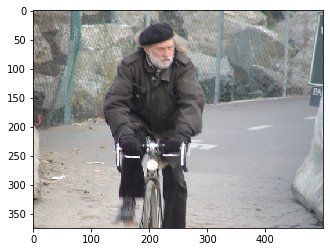

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'walking', 'on', 'a', 'sidewalk', '.']
knn ['A', 'man', 'in', 'a', 'hat', 'with', 'long', 'sleeves', 'and', 'long', 'pants', 'stands', 'overlooking', 'a', 'city', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'walking', 'on', 'a', 'sidewalk', '.']
88
_____________________________________



  9%|███████▏                                                                       | 88/970 [06:46<1:08:10,  4.64s/it]

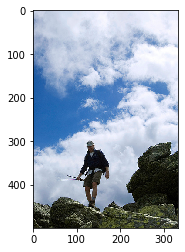

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'rock', 'climbing', '.']
knn ['A', 'group', 'of', 'people', 'sitting', 'on', 'top', 'of', 'a', 'hillside', '.']
['A', 'man', 'is', 'rock', 'climbing', '.']
89
_____________________________________



  9%|███████▏                                                                       | 89/970 [06:50<1:05:35,  4.47s/it]

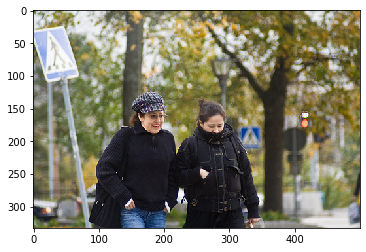

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'red', 'jacket', 'walks', 'down', 'the', 'street', '.']
knn ['A', 'performer', 'putting', 'on', 'an', 'act', 'in', 'front', 'of', 'a', 'large', 'crowd', 'of', 'people', '.']
['A', 'woman', 'in', 'a', 'red', 'jacket', 'walks', 'down', 'the', 'street', '.']
90
_____________________________________



  9%|███████▎                                                                       | 90/970 [06:54<1:05:06,  4.44s/it]

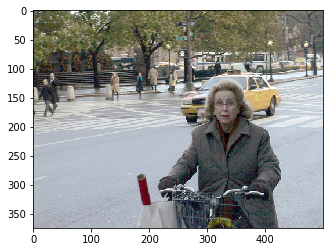

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'riding', 'bicycles', 'on', 'the', 'street', '.']
knn ['A', 'man', 'in', 'a', 'red', 'jacket', 'is', 'standing', 'by', 'a', 'bicycle', 'and', 'trailer', 'in', 'a', 'city', 'street', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'riding', 'bicycles', 'on', 'the', 'street', '.']
91
_____________________________________



  9%|███████▍                                                                       | 91/970 [06:59<1:06:31,  4.54s/it]

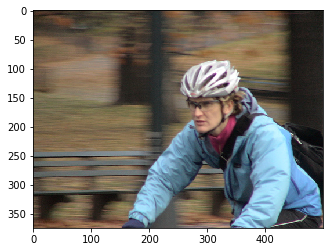

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'red', 'jacket', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'street', '.']
knn ['A', 'man', 'in', 'a', 'black', 'jacket', 'and', 'jeans', 'stands', 'in', 'front', 'of', 'a', 'brick', 'wall', '.']
['A', 'man', 'in', 'a', 'red', 'jacket', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'street', '.']
92
_____________________________________



  9%|███████▍                                                                       | 92/970 [07:04<1:07:11,  4.59s/it]

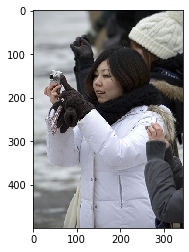

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'cup', 'in', 'front', 'of', 'a', 'tree', '.']
knn ['A', 'man', 'and', 'a', 'woman', 'sit', 'on', 'a', 'bench', 'outdoors', '.']
['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'holding', 'a', 'cup', 'in', 'front', 'of', 'a', 'tree', '.']
93
_____________________________________



 10%|███████▌                                                                       | 93/970 [07:09<1:08:24,  4.68s/it]

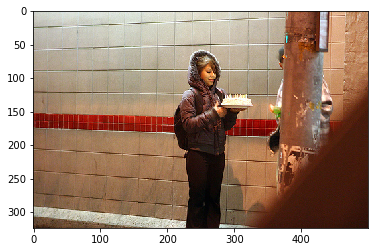

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', '.']
knn ['The', 'woman', 'wearing', 'a', 'blue', 'shirt', 'sits', 'in', 'front', 'of', 'a', 'brick', 'wall', '.']
['A', 'man', 'in', 'a', 'white', 'shirt', 'is', 'sitting', 'on', 'a', 'bench', '.']
94
_____________________________________



 10%|███████▋                                                                       | 94/970 [07:14<1:10:51,  4.85s/it]

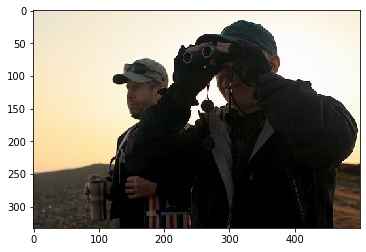

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'black', 'jacket', '.']
knn ['A', 'man', 'with', 'a', 'collarless', 'shirt', 'smokes', 'a', 'cigarette', 'in', 'front', 'of', 'a', 'courthouse', '.']
['A', 'man', 'in', 'a', 'blue', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'black', 'jacket', '.']
95
_____________________________________



 10%|███████▋                                                                       | 95/970 [07:19<1:12:01,  4.94s/it]

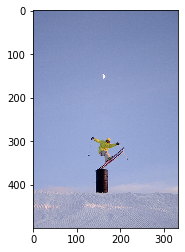

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'wetsuit', 'is', 'climbing', 'a', 'rock', 'wall', '.']
knn ['The', 'man', 'is', 'performing', 'a', 'trick', 'on', 'a', 'snowboard', 'high', 'in', 'the', 'air', '.']
['A', 'man', 'in', 'a', 'wetsuit', 'is', 'climbing', 'a', 'rock', 'wall', '.']
96
_____________________________________



 10%|███████▊                                                                       | 96/970 [07:24<1:09:30,  4.77s/it]

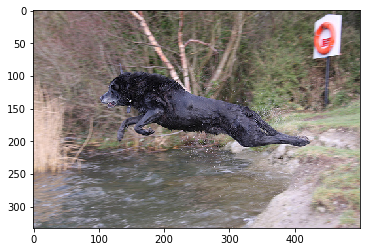

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'dog', 'is', 'swimming', 'in', 'a', 'pool', '.']
knn ['A', 'black', 'dog', 'is', 'running', 'in', 'the', 'water', '.']
['A', 'black', 'dog', 'is', 'running', 'in', 'the', 'water', '.']
97
_____________________________________



 10%|███████▉                                                                       | 97/970 [07:28<1:07:50,  4.66s/it]

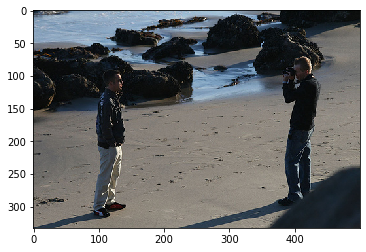

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'walking', 'along', 'the', 'beach', '.']
knn ['A', 'dog', 'is', 'running', 'on', 'the', 'beach', '.']
['A', 'dog', 'is', 'running', 'on', 'the', 'beach', '.']
98
_____________________________________



 10%|███████▉                                                                       | 98/970 [07:33<1:07:53,  4.67s/it]

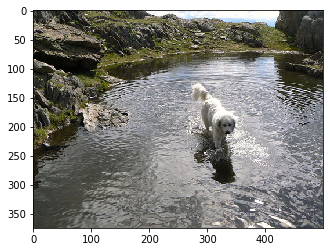

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'white', 'dog', 'fetches', 'a', 'stick', 'in', 'his', 'mouth', '.']
knn ['A', 'dog', 'running', 'through', 'the', 'water', '.']
['A', 'dog', 'running', 'through', 'the', 'water', '.']
99
_____________________________________



 10%|████████                                                                       | 99/970 [07:37<1:05:36,  4.52s/it]

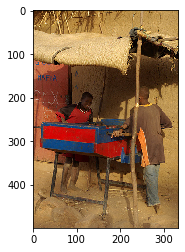

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'red', 'shirt', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'with', 'a', 'small', 'child', 'in', 'the', 'background', '.']
knn ['A', 'man', 'in', 'a', 'red', 'shirt', 'sitting', 'on', 'a', 'plastic', 'stool', 'in', 'a', 'shaded', 'sandy', 'area', '.']
['A', 'woman', 'in', 'a', 'red', 'shirt', 'is', 'sitting', 'on', 'a', 'wooden', 'bench', 'with', 'a', 'small', 'child', 'in', 'the', 'background', '.']
100
_____________________________________



 10%|████████                                                                      | 100/970 [07:42<1:09:47,  4.81s/it]

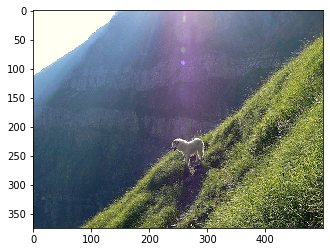

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'dog', 'runs', 'through', 'the', 'woods', '.']
knn ['A', 'white', 'dog', 'is', 'walking', 'on', 'top', 'of', 'a', 'mountain', '.']
['A', 'dog', 'runs', 'through', 'the', 'woods', '.']
101
_____________________________________



 10%|████████                                                                      | 101/970 [07:46<1:07:05,  4.63s/it]

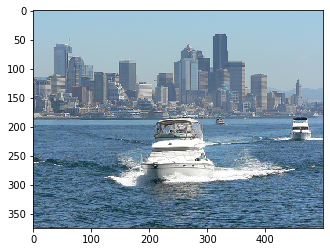

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'people', 'are', 'riding', 'a', 'boat', 'in', 'the', 'ocean', '.']
knn ['A', 'person', 'kayaking', 'in', 'the', 'ocean', '.']
['Two', 'people', 'are', 'riding', 'a', 'boat', 'in', 'the', 'ocean', '.']
102
_____________________________________



 11%|████████▏                                                                     | 102/970 [07:51<1:04:23,  4.45s/it]

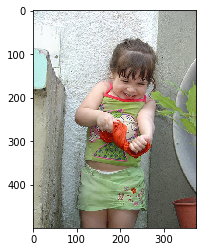

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.']
knn ['A', 'little', 'girl', 'rides', 'a', 'tricycle', '.']
['A', 'little', 'girl', 'rides', 'a', 'tricycle', '.']
103
_____________________________________



 11%|████████▎                                                                     | 103/970 [07:55<1:04:54,  4.49s/it]

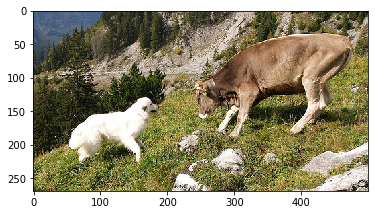

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'dogs', 'are', 'running', 'through', 'a', 'field', 'of', 'dry', 'grass', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'playing', 'with', 'a', 'golf', 'ball', 'in', 'the', 'sand', '.']
['Two', 'dogs', 'are', 'running', 'through', 'a', 'field', 'of', 'dry', 'grass', '.']
104
_____________________________________



 11%|████████▎                                                                     | 104/970 [07:59<1:03:25,  4.39s/it]

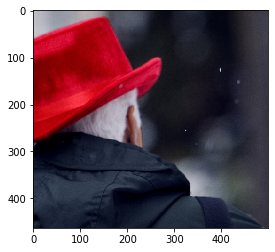

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'wearing', 'a', 'black', 'hat', 'and', 'hat', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'red', 'hat', '.']
knn ['A', 'man', 'in', 'a', 'black', 'hat', 'touches', 'a', 'cardboard', 'box', '.']
['A', 'man', 'wearing', 'a', 'black', 'hat', 'and', 'hat', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'red', 'hat', '.']
105
_____________________________________



 11%|████████▍                                                                     | 105/970 [08:05<1:08:26,  4.75s/it]

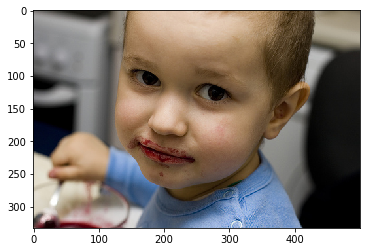

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'boy', 'is', 'blowing', 'bubbles', 'from', 'a', 'red', 'cup', '.']
knn ['A', 'man', 'with', 'a', 'Mohawk', 'smiles', 'at', 'the', 'camera', '.']
['A', 'little', 'boy', 'is', 'blowing', 'bubbles', 'from', 'a', 'red', 'cup', '.']
106
_____________________________________



 11%|████████▌                                                                     | 106/970 [08:09<1:06:49,  4.64s/it]

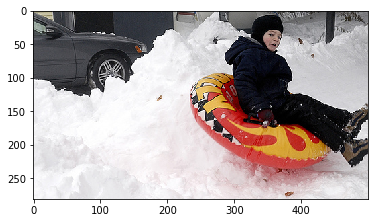

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'child', 'in', 'a', 'red', 'coat', 'is', 'sledding', 'down', 'a', 'snow', 'covered', 'hill', '.']
knn ['A', 'small', 'boy', 'playing', 'in', 'the', 'snow', '.']
['A', 'small', 'boy', 'playing', 'in', 'the', 'snow', '.']
107
_____________________________________



 11%|████████▌                                                                     | 107/970 [08:14<1:06:15,  4.61s/it]

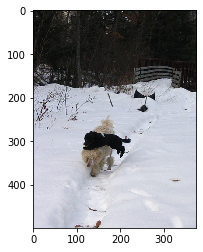

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'dog', 'runs', 'through', 'the', 'snow', '.']
knn ['Three', 'dogs', 'playing', 'in', 'the', 'snow', '.']
['Three', 'dogs', 'playing', 'in', 'the', 'snow', '.']
108
_____________________________________



 11%|████████▋                                                                     | 108/970 [08:18<1:02:58,  4.38s/it]

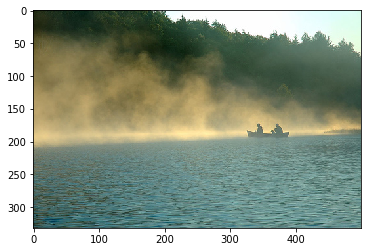

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'people', 'are', 'sitting', 'on', 'a', 'boat', 'in', 'the', 'water', '.']
knn ['A', 'man', 'surfing', 'in', 'the', 'ocean', '.']
['A', 'man', 'surfing', 'in', 'the', 'ocean', '.']
109
_____________________________________



 11%|████████▊                                                                     | 109/970 [08:22<1:02:53,  4.38s/it]

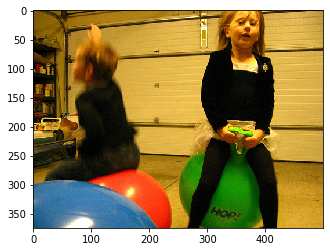

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'blue', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.']
knn ['A', 'little', 'girl', 'in', 'a', 'green', 'bathing', 'suit', 'is', 'getting', 'splashed', 'in', 'a', 'water', 'fountain', '.']
['A', 'little', 'girl', 'in', 'a', 'blue', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.']
110
_____________________________________



 11%|████████▊                                                                     | 110/970 [08:27<1:04:48,  4.52s/it]

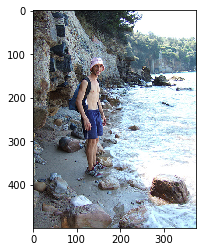

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'rocks', 'near', 'the', 'ocean', '.']
knn ['A', 'boy', 'is', 'surfing', 'in', 'the', 'ocean', '.']
['A', 'boy', 'is', 'surfing', 'in', 'the', 'ocean', '.']
111
_____________________________________



 11%|████████▉                                                                     | 111/970 [08:32<1:05:32,  4.58s/it]

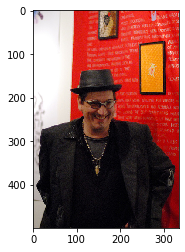

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'black', 'shirt', 'is', 'standing', 'next', 'to', 'a', 'man', 'in', 'a', 'black', 'jacket', '.']
knn ['A', 'man', 'and', 'a', 'woman', 'posing', 'in', 'front', 'of', 'a', 'christmas', 'tree', '.']
['A', 'man', 'and', 'a', 'woman', 'posing', 'in', 'front', 'of', 'a', 'christmas', 'tree', '.']
112
_____________________________________



 12%|█████████                                                                     | 112/970 [08:37<1:08:11,  4.77s/it]

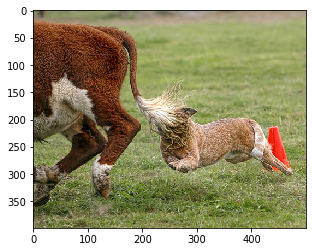

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'black', 'and', 'white', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'running', 'in', 'the', 'grass', '.']
['A', 'black', 'and', 'white', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.']
113
_____________________________________



 12%|█████████                                                                     | 113/970 [08:41<1:07:45,  4.74s/it]

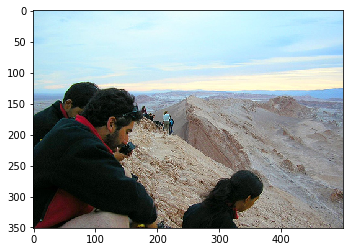

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'standing', 'on', 'top', 'of', 'a', 'mountain', '.']
knn ['a', 'man', 'fishes', 'in', 'the', 'ocean', '.']
['A', 'man', 'is', 'standing', 'on', 'top', 'of', 'a', 'mountain', '.']
114
_____________________________________



 12%|█████████▏                                                                    | 114/970 [08:46<1:07:00,  4.70s/it]

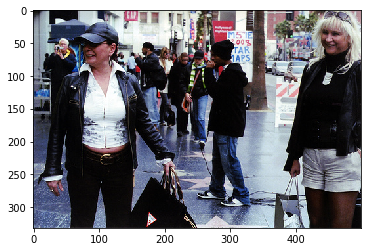

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'black', 'jacket', 'and', 'a', 'woman', 'in', 'a', 'white', 'dress', 'are', 'walking', 'down', 'the', 'street', '.']
knn ['Three', 'people', 'wearing', 'mostly', 'black', 'are', 'standing', 'in', 'front', 'of', 'a', 'blue', 'door', '.']
['Three', 'people', 'wearing', 'mostly', 'black', 'are', 'standing', 'in', 'front', 'of', 'a', 'blue', 'door', '.']
115
_____________________________________



 12%|█████████▏                                                                    | 115/970 [08:51<1:10:04,  4.92s/it]

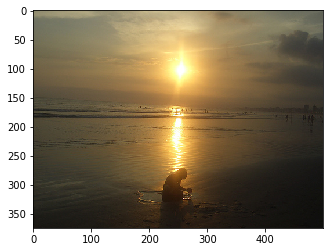

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'standing', 'on', 'a', 'rock', 'overlooking', 'the', 'ocean', '.']
knn ['A', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'ledge', 'overlooking', 'low', 'clouds', '.']
['A', 'man', 'is', 'standing', 'on', 'a', 'rock', 'overlooking', 'the', 'ocean', '.']
116
_____________________________________



 12%|█████████▎                                                                    | 116/970 [08:56<1:08:24,  4.81s/it]

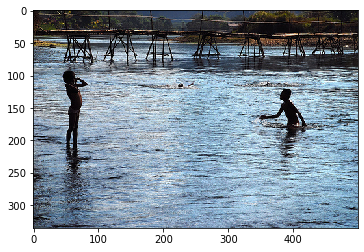

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'blue', 'bathing', 'suit', 'is', 'standing', 'on', 'a', 'dock', 'next', 'to', 'a', 'large', 'body', 'of', 'water', '.']
knn ['A', 'dog', 'swims', 'in', 'the', 'water', '.']
['A', 'dog', 'swims', 'in', 'the', 'water', '.']
117
_____________________________________



 12%|█████████▍                                                                    | 117/970 [09:01<1:10:10,  4.94s/it]

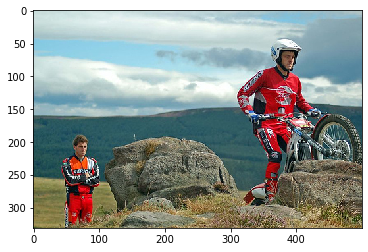

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'is', 'riding', 'a', 'bicycle', 'on', 'a', 'dirt', 'road', '.']
knn ['A', 'man', 'riding', 'a', 'bike', 'down', 'a', 'hill', '.']
['A', 'man', 'riding', 'a', 'bike', 'down', 'a', 'hill', '.']
118
_____________________________________



 12%|█████████▍                                                                    | 118/970 [09:06<1:07:39,  4.76s/it]

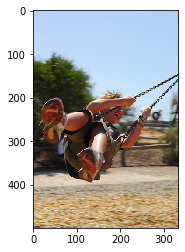

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'swinging', 'on', 'a', 'swing', '.']
knn ['A', 'man', 'jumping', 'in', 'front', 'of', 'a', 'mountain', '.']
['A', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'swinging', 'on', 'a', 'swing', '.']
119
_____________________________________



 12%|█████████▌                                                                    | 119/970 [09:10<1:06:58,  4.72s/it]

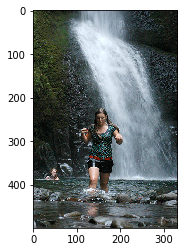

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'yellow', 'shirt', 'and', 'a', 'woman', 'in', 'a', 'blue', 'shirt', 'are', 'diving', 'into', 'a', 'lake', '.']
knn ['The', 'three', 'children', 'are', 'playing', 'in', 'a', 'fountain', '.']
['The', 'three', 'children', 'are', 'playing', 'in', 'a', 'fountain', '.']
120
_____________________________________



 12%|█████████▋                                                                    | 120/970 [09:15<1:08:53,  4.86s/it]

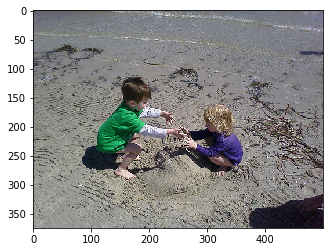

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'rocks', 'near', 'the', 'ocean', '.']
knn ['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
['A', 'young', 'girl', 'running', 'on', 'the', 'beach', '.']
121
_____________________________________



 12%|█████████▋                                                                    | 121/970 [09:20<1:09:33,  4.92s/it]

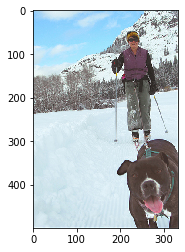

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'dog', 'is', 'running', 'through', 'the', 'snow', '.']
knn ['A', 'dog', 'playing', 'in', 'the', 'snow', '.']
['A', 'dog', 'playing', 'in', 'the', 'snow', '.']
122
_____________________________________



 13%|█████████▊                                                                    | 122/970 [09:24<1:04:34,  4.57s/it]

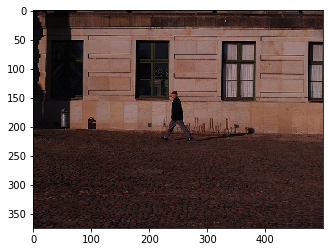

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'jeans', 'is', 'walking', 'on', 'a', 'sidewalk', 'with', 'a', 'flag', 'in', 'the', 'background', '.']
knn ['A', 'dog', 'in', 'the', 'grass', 'in', 'front', 'of', 'a', 'building', '.']
['A', 'dog', 'in', 'the', 'grass', 'in', 'front', 'of', 'a', 'building', '.']
123
_____________________________________



 13%|█████████▉                                                                    | 123/970 [09:30<1:09:06,  4.90s/it]

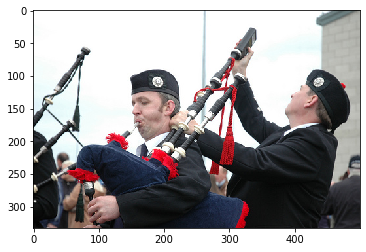

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'are', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
knn ['A', 'man', 'with', 'a', 'yellow', 'and', 'green', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
['A', 'man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'are', 'standing', 'in', 'front', 'of', 'a', 'crowd', 'of', 'people', '.']
124
_____________________________________



 13%|█████████▉                                                                    | 124/970 [09:37<1:19:48,  5.66s/it]

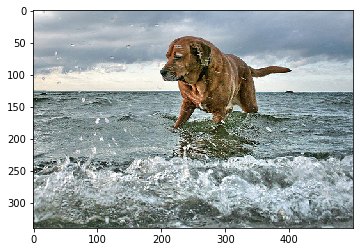

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'brown', 'dogs', 'are', 'playing', 'in', 'the', 'water', '.']
knn ['Two', 'brown', 'dogs', 'play', 'in', 'the', 'water', '.']
['Two', 'brown', 'dogs', 'play', 'in', 'the', 'water', '.']
125
_____________________________________



 13%|██████████                                                                    | 125/970 [09:41<1:12:30,  5.15s/it]

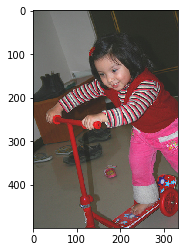

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'boy', 'wearing', 'a', 'red', 'fairy', 'outfit', 'is', 'playing', 'with', 'a', 'red', 'wheelbarrow', '.']
knn ['A', 'girl', 'in', 'a', 'purple', 'dress', 'is', 'throwing', 'a', 'tantrum', '.']
['A', 'young', 'boy', 'wearing', 'a', 'red', 'fairy', 'outfit', 'is', 'playing', 'with', 'a', 'red', 'wheelbarrow', '.']
126
_____________________________________



 13%|██████████▏                                                                   | 126/970 [09:46<1:10:32,  5.02s/it]

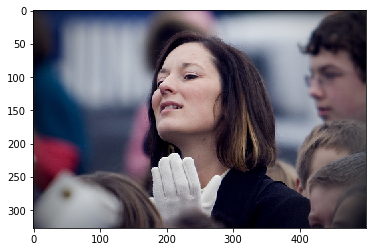

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'glasses', 'looks', 'at', 'the', 'camera', '.']
knn ['A', 'man', 'with', 'a', 'Mohawk', 'smiles', 'at', 'the', 'camera', '.']
['A', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'glasses', 'looks', 'at', 'the', 'camera', '.']
127
_____________________________________



 13%|██████████▏                                                                   | 127/970 [09:51<1:09:22,  4.94s/it]

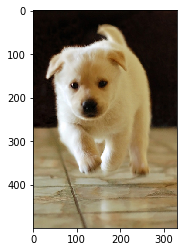

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'white', 'dog', 'with', 'a', 'red', 'collar', 'is', 'running', 'on', 'the', 'grass', '.']
knn ['A', 'white', 'curly', 'haired', 'dog', 'runs', 'with', 'a', 'stick', 'in', 'its', 'mouth', '.']
['A', 'white', 'dog', 'with', 'a', 'red', 'collar', 'is', 'running', 'on', 'the', 'grass', '.']
128
_____________________________________



 13%|██████████▎                                                                   | 128/970 [09:55<1:06:52,  4.77s/it]

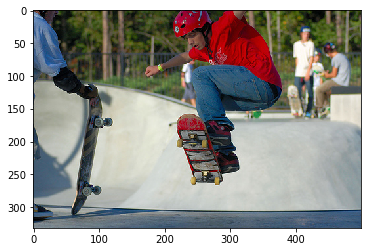

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'strapped', 'a', 'tool', 'on', 'a', 'skateboard', '.']
knn ['Little', 'boy', 'in', 'a', 'red', 'jacket', 'sliding', 'in', 'the', 'snow', '.']
['Little', 'boy', 'in', 'a', 'red', 'jacket', 'sliding', 'in', 'the', 'snow', '.']
129
_____________________________________



 13%|██████████▎                                                                   | 129/970 [10:00<1:05:34,  4.68s/it]

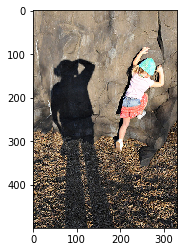

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'sitting', 'on', 'a', 'rock', 'overlooking', 'the', 'water', '.']
knn ['A', 'person', 'in', 'a', 'yellow', 'raincoat', 'is', 'sitting', 'on', 'the', 'edge', 'of', 'a', 'rock', 'looking', 'down']
['A', 'group', 'of', 'people', 'sitting', 'on', 'a', 'rock', 'overlooking', 'the', 'water', '.']
130
_____________________________________



 13%|██████████▍                                                                   | 130/970 [10:04<1:05:08,  4.65s/it]

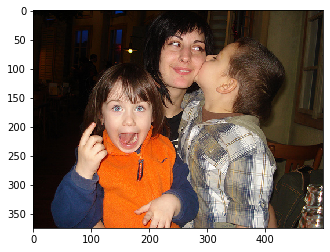

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'white', 'shirt', 'is', 'holding', 'a', 'baby', 'in', 'her', 'hand', '.']
knn ['a', 'man', 'and', 'a', 'woman', 'posing', 'for', 'a', 'picture', '.']
['a', 'man', 'and', 'a', 'woman', 'posing', 'for', 'a', 'picture', '.']
131
_____________________________________



 14%|██████████▌                                                                   | 131/970 [10:09<1:05:47,  4.71s/it]

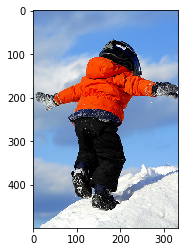

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'in', 'a', 'red', 'jacket', 'is', 'skiing', 'down', 'a', 'snowy', 'hill', '.']
knn ['A', 'man', 'skiing', 'down', 'a', 'snowy', 'hill', '.']
['A', 'man', 'skiing', 'down', 'a', 'snowy', 'hill', '.']
132
_____________________________________



 14%|██████████▌                                                                   | 132/970 [10:13<1:04:22,  4.61s/it]

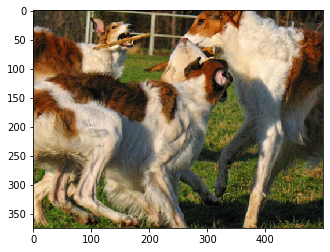

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['Two', 'dogs', 'are', 'playing', 'with', 'a', 'ball', 'in', 'a', 'field', '.']
knn ['A', 'black', 'and', 'white', 'dog', 'is', 'walking', 'on', 'a', 'beach', '.']
['Two', 'dogs', 'are', 'playing', 'with', 'a', 'ball', 'in', 'a', 'field', '.']
133
_____________________________________



 14%|██████████▋                                                                   | 133/970 [10:18<1:03:04,  4.52s/it]

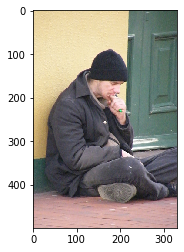

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', 'reading', 'a', 'book', '.']
knn ['A', 'man', 'in', 'a', 'black', 'jacket', 'and', 'jeans', 'stands', 'in', 'front', 'of', 'a', 'brick', 'wall', '.']
['A', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', 'reading', 'a', 'book', '.']
134
_____________________________________



 14%|██████████▊                                                                   | 134/970 [10:22<1:03:18,  4.54s/it]

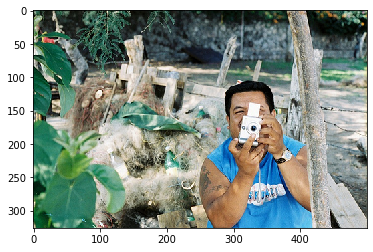

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'blowing', 'bubbles', 'from', 'a', 'tree', '.']
knn ['A', 'girl', 'in', 'a', 'blue', 'dress', 'sitting', 'on', 'the', 'ground', 'eating', 'cotton', 'candy', '.']
['A', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'blowing', 'bubbles', 'from', 'a', 'tree', '.']
135
_____________________________________



 14%|██████████▊                                                                   | 135/970 [10:27<1:03:17,  4.55s/it]

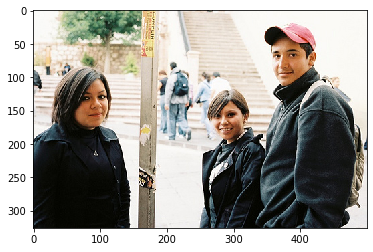

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'woman', 'in', 'a', 'red', 'jacket', 'walks', 'down', 'the', 'street', '.']
knn ['The', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
['A', 'woman', 'in', 'a', 'red', 'jacket', 'walks', 'down', 'the', 'street', '.']
136
_____________________________________



 14%|██████████▉                                                                   | 136/970 [10:32<1:04:32,  4.64s/it]

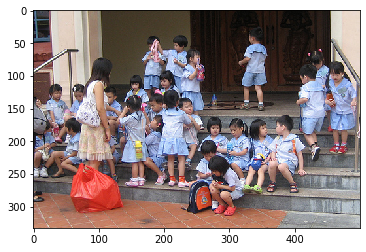

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
knn ['A', 'man', 'dancing', 'on', 'the', 'street', 'in', 'front', 'of', 'a', 'crowd', '.']
['A', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.']
137
_____________________________________



 14%|███████████                                                                   | 137/970 [10:37<1:06:28,  4.79s/it]

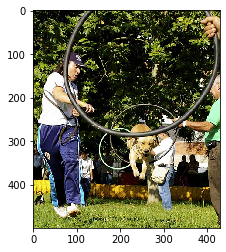

C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\ajulr\Anaconda3\lib\site-packages\nltk\translate\bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnin

lstm ['A', 'little', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'playing', 'with', 'a', 'red', 'ball', '.']
knn ['A', 'brown', 'and', 'white', 'dog', 'is', 'running', 'with', 'its', 'mouth', 'open', '.']
['A', 'little', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'playing', 'with', 'a', 'red', 'ball', '.']
138
_____________________________________



 14%|███████████                                                                   | 138/970 [10:42<1:05:47,  4.74s/it]

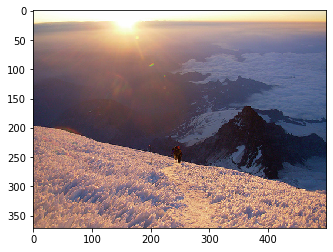

KeyboardInterrupt: 

In [63]:
from nltk.translate.bleu_score import sentence_bleu

root_captioning = 'D:\\flickr8k\\Flickr8k\\Flickr8k_Dataset\\Flickr8k_Dataset'
# print(lookup)
pc1=[]
pc2=[]
pc3=[]
pc4=[]
groundTruth = []

count=0
for z in tqdm(range(30,1000)):
  count+=1
  pic = list(encoding_testlstm.keys())[z]

  image = encoding_testlstm[pic].reshape((1,OUTPUT_DIM))
#   print(os.path.join(root_captioning, pic))
  x=plt.imread(os.path.join(root_captioning, pic))
  plt.imshow(x)
  plt.show()
#   print("Caption:",generateCaptionbs(image))

  captionFromKNN = prepKNN(pic)
#   print(captionFromKNN)
  #cs= generateCaptionBeamSearch(image,30)
  cs2=generateCaptionBeamSearchModified(image,3)
  #cs3=propModel(cs2, captionFromKNN)

  probab = cs2[1]
  cs2 = cs2[0]
  print( 'lstm', cs2)
  print('knn', captionFromKNN[0][0])
  pc1.append(captionFromKNN[0][0])
  pc2.append(cs2)
  
  references=[]
  score=0
  
  reference=lookup[pic]
  for i in reference:
      rs=i.split()
      references.append(rs)
  logisticFeatures = np.array([probab, captionFromKNN[0][1], captionFromKNN[1], len(captionFromKNN[0][0])/32, len(cs2)/32])
  lstmBetter = classifier.predict(logisticFeatures.reshape(1,-1))
  if lstmBetter == 1:
        print(cs2)
        pc3.append(cs2)
  else :
    print(captionFromKNN[0][0])
    pc3.append(captionFromKNN[0][0])
        
  #put(x_train, y_train, logisticFeatures, lstmBetter, abs(val))
    
  groundTruth.append(references)  
  print(count)

  
  
  print("_____________________________________")


In [70]:
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc1))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc2, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc2))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc3))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc4, weights=(1, 0, 0, 0)))
print(nltk.translate.bleu_score.corpus_bleu(groundTruth, pc4))

0.560234122477505
0.15956231752059055
0.5812226391494684
0.1601379456957741
0.5967312133593888
0.1820357248400809
0.5698916161938158
0.1619807056891054
